C:\Users\Shawn Holland\Documents\code\databops\covid-tracking


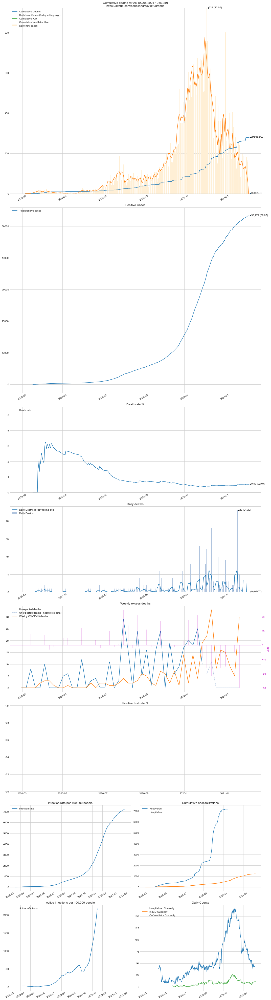

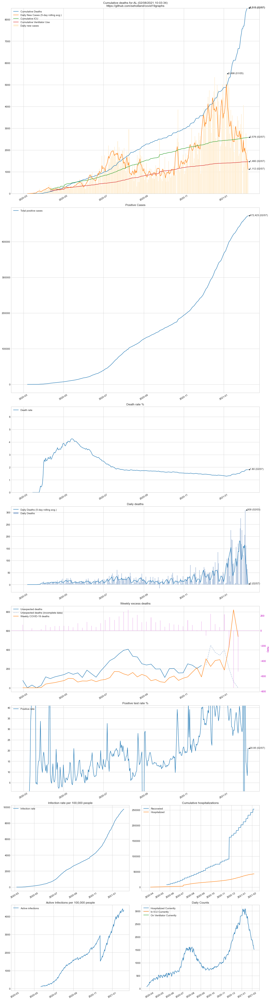

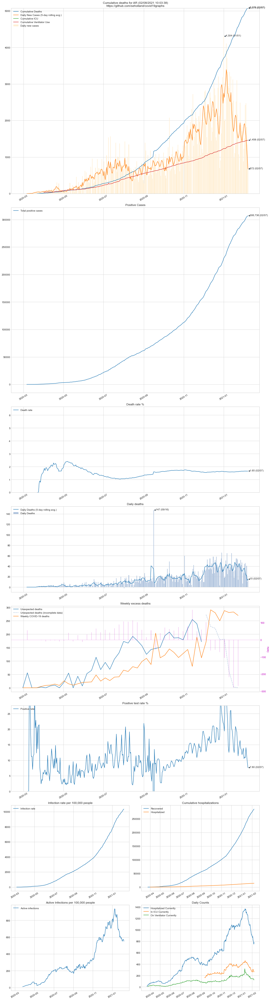

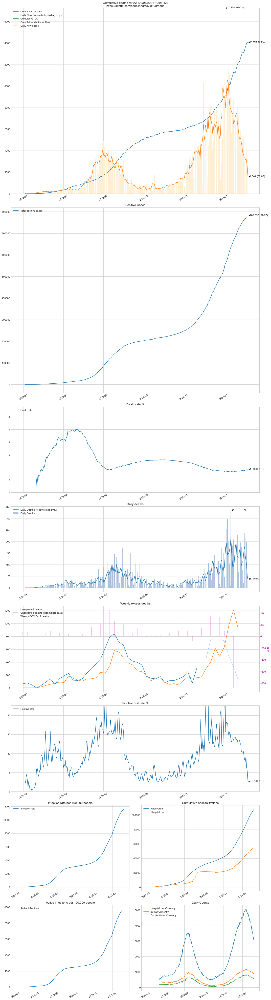

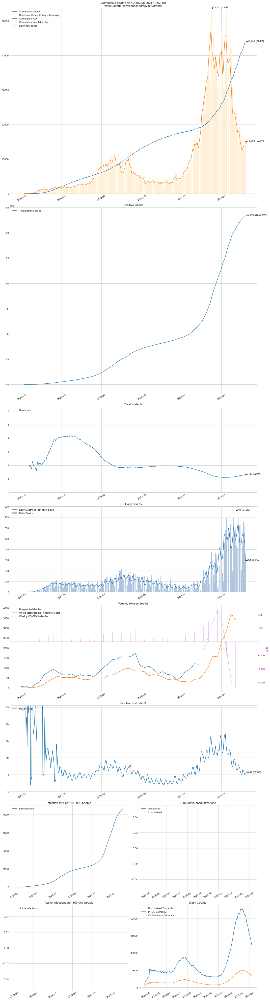

...

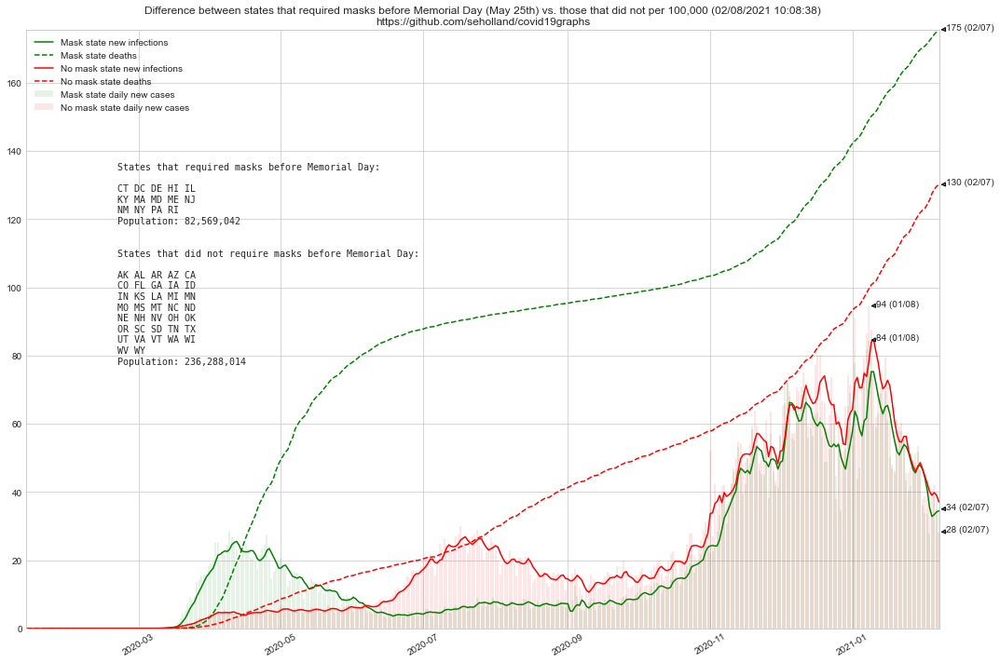

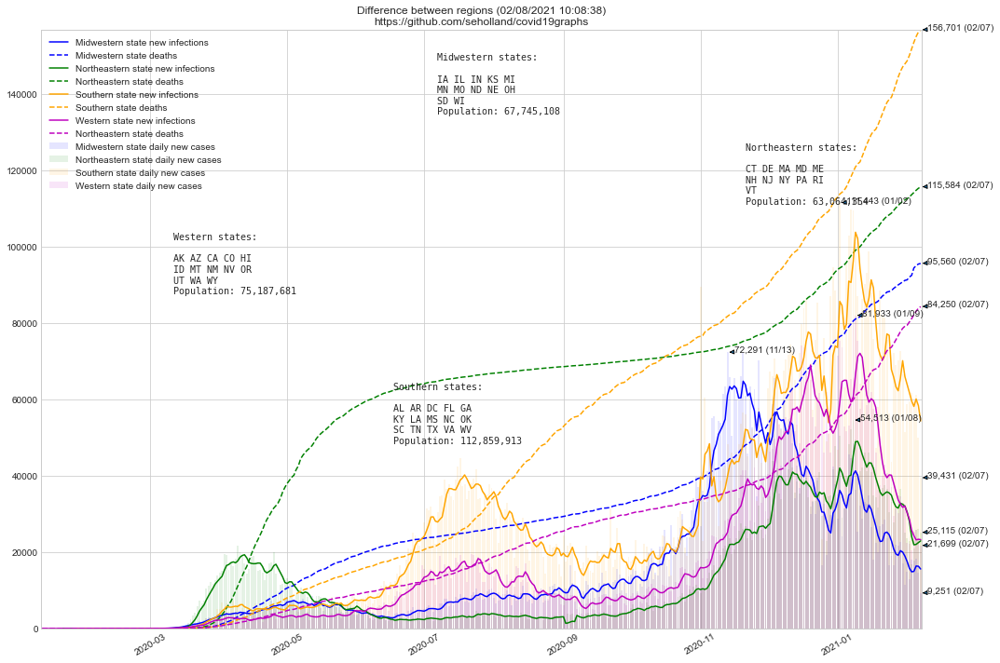

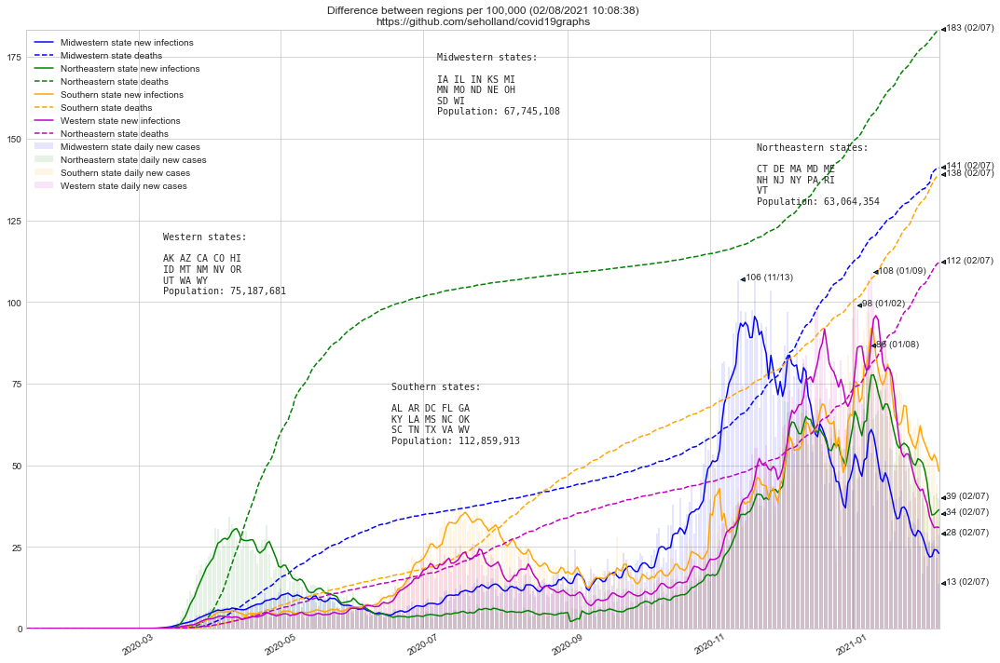

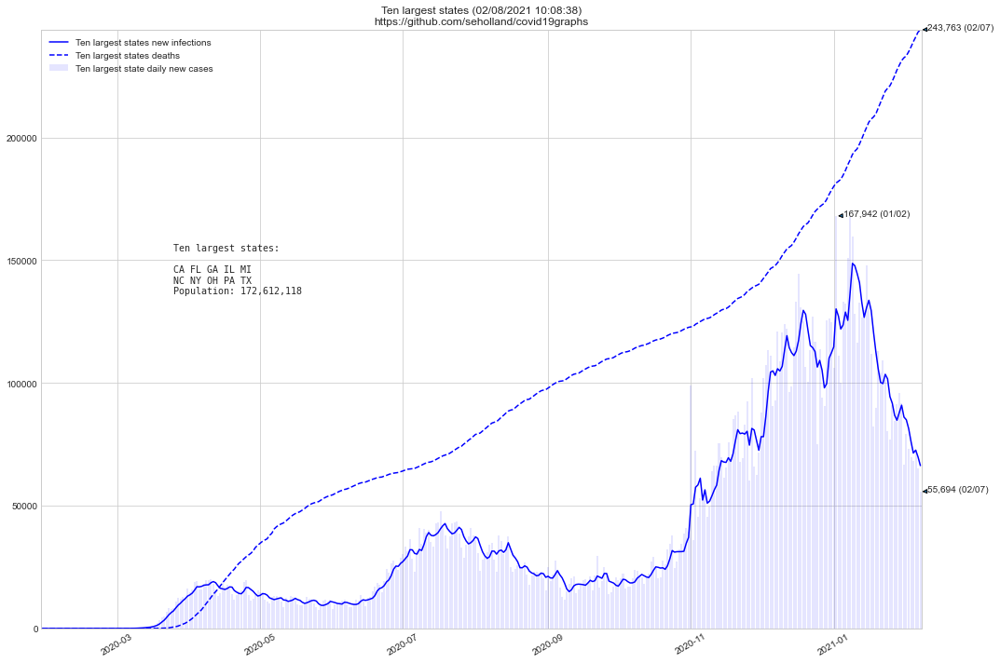

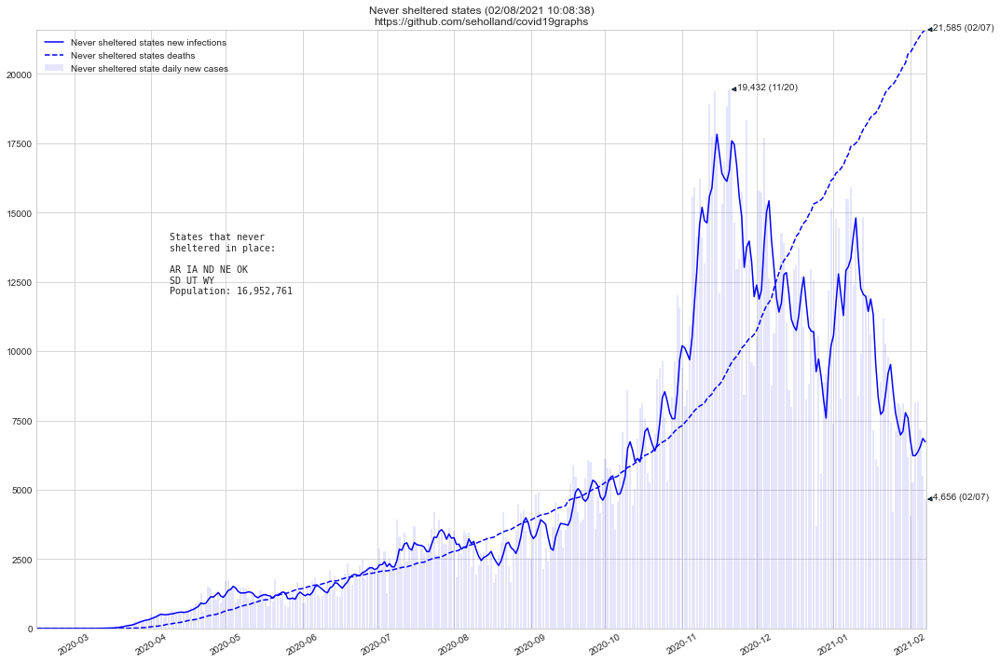

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1924: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1937: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


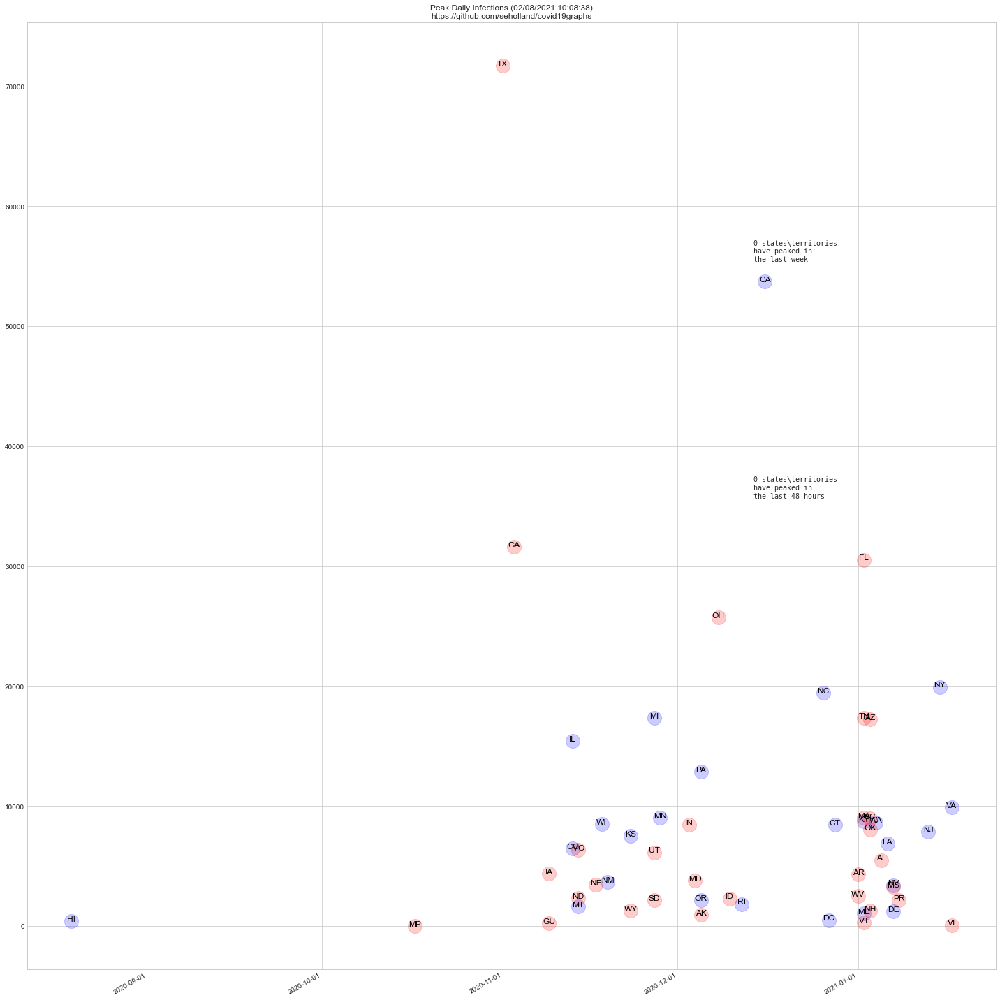

In [5]:
import json
import math
import urllib
from datetime import datetime, timedelta
from os import path
import matplotlib.dates as mdates
import pandas as pd
import numpy as np
import sys
from sodapy import Socrata

cdc_client = client = Socrata("data.cdc.gov", "EfDgKSiRaXMoLthc8UuyyicjK")

force_reload = True
pwd = sys.path[0]
print(pwd)

states_info_url = 'https://covidtracking.com/api/v1/states/info.json'
state_historical_url = 'https://covidtracking.com/api/v1/states/' # just add 'ma/current.json' to specify Massachusetts

# Load up the population of each state
states_population = None
states_population_path = pwd + '\\state_pop.json'
if force_reload or not path.exists(states_population_path):
	response = urllib.request.urlopen('https://api.census.gov/data/2014/pep/natstprc?get=STNAME,POP&DATE_=7&for=state:*')
	charset = response.headers.get_content_charset()
	if not charset:
		charset = 'utf-8'

	states_population_string = response.read().decode(charset)
	states_population = pd.read_json(states_population_string)
	with open(states_population_path, 'wt') as f:
		f.write(states_population_string)
else:
	with open(states_population_path) as f:
		states_population = pd.read_json(f.read())

states_population = states_population.drop(states_population.index[0])
states_population.fillna(0)
states_population.index = states_population[3]

# Next, load  the available state / territory
state_info_path = pwd + '\\state_info.json'
states_info = None
if force_reload or not path.exists(state_info_path):
	response = urllib.request.urlopen(states_info_url)
	charset = response.headers.get_content_charset()
	if not charset:
		charset = 'utf-8'
	states_info_string = response.read().decode(charset)
	states_info = json.loads(states_info_string)
	with open(state_info_path, 'wt') as f:
		f.write(states_info_string)
else:
	with open(state_info_path) as f:
		states_info = json.loads(f.read())

# Add the US to the list of graphs
states_info.append({'state':'US'})

# Also set up a population lookup table
state_population_dict = {}

# Load historical data for each state. Refresh if the data is more than an hour old
weekly_death_delta = pd.Series(dtype = 'object')
weekly_new_case_delta = pd.Series(dtype = 'object')
weekly_score = pd.Series(dtype = 'object')
weekly_death_rate = pd.Series(dtype = 'object')
weekly_infection_pct = pd.Series(dtype = 'object')
positive_rate = pd.Series(dtype = 'object')
positive_rate_colors = pd.Series(dtype = 'object')
active_infections = pd.Series(dtype = 'object')
active_infection_colors = pd.Series(dtype = 'object')

us_excess_deaths = pd.DataFrame()

# Red vs Blue
# Create a mapping to the political party of the governor
is_democrat = ['CA', 'CO', 'CT', 'DE', 'HI', 'IL', 'KS', 'KY', 'LA','ME', 'MI', 'MN', 'MT', 'NV', 'NJ', 'NM', 'NY', 'NC', 'OR', 'PA', 'RI', 'VA', 'WA', 'WI', 'DC']
republican_cases = pd.Series(dtype = 'object')
republican_deaths = pd.Series(dtype = 'object')
democrat_cases = pd.Series(dtype = 'object')
democrat_deaths = pd.Series(dtype = 'object')

# Create a mapping to the 2016 election
is_hillary = ['CA', 'CO', 'CT', 'DC', 'DE', 'HI', 'IL', 'ME', 'MD', 'MA', 'MN', 'NV', 'NH', 'NJ', 'NM', 'NY', 'OR', 'RI', 'VT', 'VA', 'WA']
is_territory = ['AS', 'GU', 'MP', 'PR', 'VI']

hillary_cases = pd.Series(dtype= 'object')
hillary_deaths = pd.Series(dtype = 'object')
trump_cases = pd.Series(dtype = 'object')
trump_deaths = pd.Series(dtype = 'object')

# Map the difference between states that require a mask and those that do not
requires_mask = ['AL', 'AR', 'CA', 'CO', 'CT', 'DC', 'DE', 'HI', 'IL', 'ID', 'KS', 'KY', 'LA', 'ME', 'MD', 'MA', 'MI', 'MT',
				 'NV', 'NH', 'NJ', 'NM', 'NY', 'NC', 'OH', 'OR', 'PA', 'RI', 'TX', 'VA', 'VT', 'WA', 'WV', 'WI']
mask_cases = pd.Series(dtype='object')
mask_deaths = pd.Series(dtype='object')
covidiot_cases = pd.Series(dtype='object')
covidiot_deaths = pd.Series(dtype='object')

# The following list taken from
# https://www.cnn.com/2020/06/19/us/states-face-mask-coronavirus-trnd/index.html
pre_mem_requires_mask = ['CT', 'DC', 'DE', 'HI', 'IL', 'KY', 'ME', 'MD', 'MA', 'NJ', 'NM', 'NY', 'PA', 'RI']
pre_mem_mask_cases = pd.Series(dtype='object')
pre_mem_mask_deaths = pd.Series(dtype='object')
pre_mem_covidiot_cases = pd.Series(dtype='object')
pre_mem_covidiot_deaths = pd.Series(dtype='object')

# Regional differences
# Create a region map
is_ten_largest = ['IL', 'NC', 'NY', 'GA', 'OH', 'TX', 'PA', 'MI', 'CA', 'FL']
is_never_shelter = ['UT', 'NE', 'AR', 'ND', 'IA', 'SD', 'WY', 'OK']
is_north_east = ['CT', 'ME', 'NH', 'MA', 'RI', 'MD', 'NJ', 'VT', 'NY', 'DE', 'PA' ]
is_west = ['UT', 'CO', 'AZ', 'NM', 'OR', 'CA', 'NV', 'AK', 'WA', 'WY', 'ID', 'HI', 'MT']
is_midwest = ['IL', 'NE', 'MO', 'OH', 'ND', 'IN', 'MN', 'MI', 'IA', 'SD', 'KS', 'WI']
is_south = ['DC', 'NC', 'VA', 'AR', 'TN', 'MS', 'SC', 'GA', 'AL', 'TX', 'LA', 'KY', 'FL', 'OK', 'WV']
ten_largest_cases = pd.Series(dtype = 'object')
ten_largest_deaths = pd.Series(dtype = 'object')
never_shelter_cases = pd.Series(dtype = 'object')
never_shelter_deaths = pd.Series(dtype = 'object')
northeast_cases = pd.Series(dtype = 'object')
northeast_deaths = pd.Series(dtype = 'object')
west_cases = pd.Series(dtype = 'object')
west_deaths = pd.Series(dtype = 'object')
midwest_cases = pd.Series(dtype = 'object')
midwest_deaths = pd.Series(dtype = 'object')
south_cases = pd.Series(dtype = 'object')
south_deaths = pd.Series(dtype = 'object')

peak_cases_dates = []
peak_cases_numbers = []
peak_cases_states = []
peak_cases_party_color = []


for state_info in states_info:
	state = state_info['state']

	if state == 'AS':
		continue
	
	state_frame = None
	state_file = pwd + f"\\{state}.json"
	if force_reload or not path.exists(state_file):
		if state is not 'US':
			query = f"{state_historical_url}{state.lower()}/daily.json"
		else:
			query = f"https://covidtracking.com/api/v1/us/daily.json"

		response = urllib.request.urlopen(query)
		charset = response.headers.get_content_charset()
		if not charset:
			charset = 'utf-8'
		state_history_string = response.read().decode(charset)
		json_state_history = json.loads(state_history_string)
		if isinstance(json_state_history, dict) and  'error' in json_state_history.keys():
			print(f'Error retrieving info for {state}')
			continue

		state_frame = pd.read_json(state_history_string,  convert_dates = True)
		with open(state_file, 'wt') as f:
			f.write(state_history_string)
	else:
		with open(state_file) as f:
			state_frame = pd.read_json(f.read(), convert_dates = True)
	
	state_frame.fillna(0)
	state_frame.index = pd.to_datetime(state_frame.date, format='%Y%m%d')
	state_frame.sort_index()

	weekly_death_rate.at[state] = ((state_frame.death / state_frame.positive) * 100).iloc[0]
	current_positive_rate = ((state_frame.positiveIncrease / state_frame.totalTestResultsIncrease) * 100).iloc[0]
	positive_rate.at[state] = current_positive_rate
	if current_positive_rate >= 10:
		positive_rate_colors[state] = 'r'
	elif current_positive_rate > 3:
		positive_rate_colors[state] = 'orange'
	else: # 3% or lower means there is adequate testing
		positive_rate_colors[state] = 'g'

	# Accumulate along political and regional lines
	if state is not 'US':
		if state in is_democrat:
			democrat_cases = democrat_cases.add(state_frame.positiveIncrease, fill_value=0)
			democrat_deaths = democrat_deaths.add(state_frame.death, fill_value=0)
		else:
			republican_cases = republican_cases.add(state_frame.positiveIncrease, fill_value=0)
			republican_deaths = republican_deaths.add(state_frame.death, fill_value=0)

		if state in is_hillary:
			hillary_cases = hillary_cases.add(state_frame.positiveIncrease, fill_value=0)
			hillary_deaths = hillary_deaths.add(state_frame.death, fill_value=0)
		elif state not in is_territory:
			trump_cases = trump_cases.add(state_frame.positiveIncrease, fill_value=0)
			trump_deaths = trump_deaths.add(state_frame.death, fill_value=0)

		if state in requires_mask:
			mask_cases = mask_cases.add(state_frame.positiveIncrease, fill_value=0)
			mask_deaths = mask_deaths.add(state_frame.death, fill_value=0)
		elif state not in is_territory:
			covidiot_cases = covidiot_cases.add(state_frame.positiveIncrease, fill_value=0)
			covidiot_deaths = covidiot_deaths.add(state_frame.death, fill_value=0)

		if state in pre_mem_requires_mask:
			pre_mem_mask_cases = pre_mem_mask_cases.add(state_frame.positiveIncrease, fill_value=0)
			pre_mem_mask_deaths = pre_mem_mask_deaths.add(state_frame.death, fill_value=0)
		elif state not in is_territory:
			pre_mem_covidiot_cases = pre_mem_covidiot_cases.add(state_frame.positiveIncrease, fill_value=0)
			pre_mem_covidiot_deaths = pre_mem_covidiot_deaths.add(state_frame.death, fill_value=0)

		if state in is_ten_largest:
			ten_largest_cases = ten_largest_cases.add(state_frame.positiveIncrease, fill_value=0)
			ten_largest_deaths = ten_largest_deaths.add(state_frame.death, fill_value=0)

		if state in is_never_shelter:
			never_shelter_cases = never_shelter_cases.add(state_frame.positiveIncrease, fill_value=0)
			never_shelter_deaths = never_shelter_deaths.add(state_frame.death, fill_value=0)

		if state in is_north_east:
			northeast_cases = northeast_cases.add(state_frame.positiveIncrease, fill_value=0)
			northeast_deaths = northeast_deaths.add(state_frame.death, fill_value=0)

		if state in is_west:
			west_cases = west_cases.add(state_frame.positiveIncrease, fill_value=0)
			west_deaths = west_deaths.add(state_frame.death, fill_value=0)

		if state in is_midwest:
			midwest_cases = midwest_cases.add(state_frame.positiveIncrease, fill_value=0)
			midwest_deaths = midwest_deaths.add(state_frame.death, fill_value=0)

		if state in is_south:
			south_cases = south_cases.add(state_frame.positiveIncrease, fill_value=0)
			south_deaths = south_deaths.add(state_frame.death, fill_value=0)

		# Find when this state hit its peak and when
		peak_cases_dates.append(state_frame.positiveIncrease.idxmax())
		peak_cases_numbers.append(state_frame.positiveIncrease.max())
		peak_cases_states.append(state)
		peak_cases_party_color.append('b' if state in is_democrat else 'r')


	# Record the weekly deltas
	last_weeks_deaths = state_frame.iloc[14:21].deathIncrease.sum()
	this_weeks_deaths = state_frame.iloc[:14].deathIncrease.sum()
	deaths_delta = None
	if last_weeks_deaths == 0 :
		if this_weeks_deaths > 0 :
			deaths_delta = 100
		elif this_weeks_deaths < 0:
			deaths_delta = -100
		else:
			deaths_delta = 0
	else:
		deaths_delta = ((this_weeks_deaths - last_weeks_deaths) / last_weeks_deaths) * 100

	weekly_death_delta.at[state] = deaths_delta

	last_weeks_new_cases = state_frame.iloc[14:21].positiveIncrease.sum()
	this_weeks_new_cases = state_frame.iloc[:14].positiveIncrease.sum()
	new_cases_delta = None
	if last_weeks_new_cases == 0 :
		if this_weeks_new_cases > 0 :
			new_cases_delta = 100
		elif this_weeks_new_cases < 0:
			new_cases_delta = -100
		else:
			new_cases_delta = 0
	else:
		new_cases_delta = ((this_weeks_new_cases - last_weeks_new_cases) / last_weeks_new_cases) * 100

	weekly_new_case_delta.at[state] = new_cases_delta
	weekly_score.at[state] = new_cases_delta + deaths_delta

	#Grab the population for this state
	try:
		if state is not 'US':
			state_population = int(states_population.loc[state_info['fips']][1])
		else:
			state_population = 328200000
	except KeyError:
		#So we don't divide by zero
		state_population = 1

	state_population_dict[state] = state_population
	if state_population is not 1:
		weekly_infection_pct[state] = (state_frame.positive.iloc[0] / state_population) * 100
		current_active_count = ((state_frame.positive - state_frame.death - state_frame.recovered)/(state_population/ 100000)).iloc[0]
		active_infections[state] = current_active_count

		if current_active_count >= 1000 or np.isnan(current_active_count):
			active_infection_colors[state] = 'r'
		elif current_active_count > 300:
			active_infection_colors[state] = 'orange'
		else:
			active_infection_colors[state] = 'g'
	else:
		active_infection_colors[state] = 'r'


	# Get unexpected deaths for this state
	if state is not 'US':
		state_cdc_file = pwd + f"\\{state}-unexpected-deaths.json"
		if force_reload or not path.exists(state_cdc_file):
			try:
				unexpected_deaths = cdc_client.get("xkkf-xrst", state=state_info['name'])
				with open(state_cdc_file, 'wt') as f:
					json.dump(unexpected_deaths, f)
				state_cdc_frame = pd.DataFrame.from_records(unexpected_deaths)
			except:
				with open(state_cdc_file) as f:
					state_cdc_frame = pd.read_json(f.read(), convert_dates = True)
		else:
			with open(state_cdc_file) as f:
				state_cdc_frame = pd.read_json(f.read(), convert_dates = True)

		if state_cdc_frame.size > 0:
			state_cdc_frame = state_cdc_frame.loc[((state_cdc_frame.week_ending_date > '2020-02-22') & (state_cdc_frame.type == 'Unweighted'))]
			state_cdc_frame.fillna(0)
			state_cdc_frame.index = pd.to_datetime(state_cdc_frame.week_ending_date, format='%Y-%m-%d')
			state_cdc_frame.excess_higher_estimate = pd.to_numeric(state_cdc_frame.excess_higher_estimate, errors='coerce')
			state_cdc_frame.sort_index()
			state_cdc_frame.drop(['average_expected_count', 'exceeds_threshold',
                                        'excess_lower_estimate', 'note', 'observed_number', 'outcome',
                                        'percent_excess_higher_estimate', 'percent_excess_lower_estimate',
                                        'state', 'total_excess_higher_estimate_in_2020',
                                        'total_excess_lower_estimate_in_2020', 'type', 'upper_bound_threshold',
                                        'week_ending_date', 'year'], axis=1, inplace=True)
			if 'suppress' in state_cdc_frame:
				state_cdc_frame.drop(['suppress' ], axis=1, inplace=True)

			us_excess_deaths = us_excess_deaths.add(state_cdc_frame, fill_value=0)
		else:
			state_cdc_frame = None
	else:
		state_cdc_frame = us_excess_deaths

	# print(state_frame)
	%matplotlib inline
	import matplotlib.pyplot as plt
	plt.style.use('seaborn-whitegrid')
	from matplotlib.dates import MonthLocator, HourLocator, DateFormatter, drange
	from matplotlib.font_manager import FontProperties
	datetime_string = datetime.now().strftime("%m/%d/%Y %H:%M:%S")

	# continue

	# Make the plot
	fig = plt.figure()
	ax1 = plt.subplot2grid((10, 1), (0, 0), rowspan = 2)
	ax2 = plt.subplot2grid((10, 1), (2, 0), rowspan = 2, sharex=ax1)
	ax3 = plt.subplot2grid((10, 1), (4, 0), sharex=ax1)
	ax4 = plt.subplot2grid((10, 1), (5, 0), sharex=ax1)
	ax5 = plt.subplot2grid((10, 1), (6, 0), sharex=ax1)
	ax6 = plt.subplot2grid((10, 1), (7, 0), sharex=ax1)
	ax7 = plt.subplot2grid((10, 2), (8, 0))
	ax8 = plt.subplot2grid((10, 2), (8, 1))
	ax9 = plt.subplot2grid((10, 2), (9, 0), sharex=ax7)
	ax10 = plt.subplot2grid((10, 2), (9, 1), sharex=ax8)

		# , (ax1, ax2) = plt.subplots(2, 1)
	ax1.locator_params(axis='x', nbins=5)
	ax1.set_title(f"Cumulative deaths for {state} ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
	ax1.plot(state_frame.index, state_frame.death, label='Cumulative Deaths')

	# Label the current value
	ax1.annotate(f"{'{:,}'.format(int(state_frame.death.iloc[0]))} ({state_frame.index[0].strftime('%m/%d')})",
				 xy=(state_frame.index[0], state_frame.death.iloc[0]),
				 xytext= (mdates.date2num(state_frame.index[0])  + 3, state_frame.death.iloc[0]),
				arrowprops=dict(arrowstyle='-|>'))

	# Label the peak value
	ax1.annotate(f"{'{:,}'.format(int(state_frame.death.max()))} ({state_frame.death.idxmax().strftime('%m/%d')})",
    				 xy=(state_frame.death.idxmax(), state_frame.death.max()),
    				 xytext= (mdates.date2num(state_frame.death.index[0])  + 3, state_frame.death.max()),
    				arrowprops=dict(arrowstyle='-|>'))

	ax1.plot(state_frame.index, state_frame.rolling(window=5, min_periods=1)['positiveIncrease'].mean(), label='Daily New Cases (5-day rolling avg.)')
	ax1.bar(state_frame.index, state_frame.positiveIncrease, color='papayawhip',  label='Daily new cases' )
	# Label the current value
	ax1.annotate(f"{'{:,}'.format(int(state_frame.positiveIncrease.iloc[0]))} ({state_frame.index[0].strftime('%m/%d')})",
		xy=(state_frame.index[0], state_frame.positiveIncrease.iloc[0]),
		xytext= (mdates.date2num(state_frame.index[0])  + 3, state_frame.positiveIncrease.iloc[0]),
		arrowprops=dict(arrowstyle='-|>'))

	# Label the peak value
	ax1.annotate(f"{'{:,}'.format(int(state_frame.positiveIncrease.max()))} ({state_frame.positiveIncrease.idxmax().strftime('%m/%d')})",
		xy=(state_frame.positiveIncrease.idxmax(), state_frame.positiveIncrease.max()),
		xytext= (mdates.date2num(state_frame.positiveIncrease.idxmax())  + 3, state_frame.positiveIncrease.max()),
		arrowprops=dict(arrowstyle='-|>'))

	ax1.plot(state_frame.index, state_frame.inIcuCumulative, label='Cumulative ICU')
	if state_frame.inIcuCumulative.iloc[0] > 0:
		ax1.annotate(f"{'{:,}'.format(int(state_frame.inIcuCumulative.iloc[0]))} ({state_frame.index[0].strftime('%m/%d')})",
						 xy=(state_frame.index[0], state_frame.inIcuCumulative.iloc[0]),
						  xytext= (mdates.date2num(state_frame.index[0])  + 3, state_frame.inIcuCumulative.iloc[0]),
						 arrowprops=dict(arrowstyle='-|>'))
	ax1.plot(state_frame.index, state_frame.onVentilatorCumulative, label='Cumulative Ventilator Use')
	if state_frame.onVentilatorCumulative.iloc[0] > 0:
		ax1.annotate(f"{'{:,}'.format(int(state_frame.onVentilatorCumulative.iloc[0]))} ({state_frame.index[0].strftime('%m/%d')})",
					 xy=(state_frame.index[0], state_frame.onVentilatorCumulative.iloc[0]),
					  xytext= (mdates.date2num(state_frame.index[0])  + 3, state_frame.onVentilatorCumulative.iloc[0]),
					 arrowprops=dict(arrowstyle='-|>'))
	ax1.margins(0, 0)
	ax1.set_ylim(0)
	ax1.legend(loc='upper left')
	for tick in ax1.get_xticklabels():
		tick.set_rotation(30)

	# Positive cases
	ax2.set_title('Positive Cases')
	ax2.plot(state_frame.index, state_frame.positive, label='Total positive cases')
	if state_frame.positive.iloc[0] > 0:
		ax2.annotate(f"{'{:,}'.format(int(state_frame.positive.iloc[0]))} ({state_frame.index[0].strftime('%m/%d')})",
				xy=(state_frame.index[0], state_frame.positive.iloc[0]),
				xytext= (mdates.date2num(state_frame.index[0])  + 3, state_frame.positive.iloc[0]),
				arrowprops=dict(arrowstyle='-|>'))
	ax2.legend(loc='upper left')
	for tick in ax2.get_xticklabels():
		tick.set_rotation(30)

	# Death rate %
	ax3.set_title('Death rate %')
	ax3.plot(state_frame.index, (state_frame.death / state_frame.positive) * 100, label='Death rate')
	center_value = ((state_frame.death / state_frame.positive) * 100).iloc[0]
	if not math.isnan(center_value):
		min_value = max(0, center_value - 5)
		max_value = center_value + 5
		ax3.set_ylim(min_value, max_value)
	if center_value > 0:
		ax3.annotate(f"{'{:.2f}'.format(center_value)} ({state_frame.index[0].strftime('%m/%d')})",
			xy=(state_frame.index[0], center_value),
			xytext= (mdates.date2num(state_frame.index[0])  + 3, center_value),
			arrowprops=dict(arrowstyle='-|>'))
	ax3.legend(loc='upper left')
	for tick in ax3.get_xticklabels():
			tick.set_rotation(30)

	# Daily deaths
	ax4.set_title('Daily deaths')
	ax4.plot(state_frame.index, state_frame.rolling(window=5, min_periods=1)['deathIncrease'].mean(), label='Daily Deaths (5-day rolling avg.)')
	ax4.bar(state_frame.index, state_frame.deathIncrease, color='lightsteelblue', label='Daily Deaths')
	# Label the current value
	ax4.annotate(f"{'{:,}'.format(int(state_frame.deathIncrease.iloc[0]))} ({state_frame.index[0].strftime('%m/%d')})",
		xy = (state_frame.index[0], state_frame.deathIncrease.iloc[0]),
		xytext = (mdates.date2num(state_frame.index[0])  + 3, state_frame.deathIncrease.iloc[0]),
		arrowprops=dict(arrowstyle='-|>'))

	#Label the peak value
	ax4.annotate(f"{'{:,}'.format(int(state_frame.deathIncrease.max()))} ({state_frame.deathIncrease.idxmax().strftime('%m/%d')})",
		xy = (state_frame.deathIncrease.idxmax(), state_frame.deathIncrease.max()),
		xytext = (mdates.date2num(state_frame.deathIncrease.idxmax())  + 3, state_frame.deathIncrease.max()),
		arrowprops=dict(arrowstyle='-|>'))

	ax4.legend(loc='upper left')
	for tick in ax4.get_xticklabels():
    		tick.set_rotation(30)

	# Weekly excess deaths
	ax5.set_title('Weekly excess deaths')
	if state_cdc_frame is not None:
		ten_weeks_ago = datetime.today() - timedelta(weeks=10)
		ax5.plot(state_cdc_frame.index[state_cdc_frame.index < ten_weeks_ago], pd.to_numeric(state_cdc_frame.excess_higher_estimate[state_cdc_frame.index < ten_weeks_ago]), label='Unexpected deaths')
		ax5.plot(state_cdc_frame.index[state_cdc_frame.index >= ten_weeks_ago], pd.to_numeric(state_cdc_frame.excess_higher_estimate[state_cdc_frame.index >= ten_weeks_ago]), color='lightsteelblue', label='Unexpected deaths (incomplete data)', linestyle='--')

		# Also plot the weekly sums for periods ending on Saturday
		# to compare to the CDC's excess deaths reporting.
		# The two should be very similar
		weekly_deaths = pd.Series(dtype = 'object')
		for end_date in state_cdc_frame.index:
			weekly_deaths[end_date] = state_frame.deathIncrease[(end_date - timedelta(days=7) < state_frame.index) & (state_frame.index <= end_date)].sum()
		ax5.plot(weekly_deaths.index, weekly_deaths, label='Weekly COVID-19 deaths')

		ax5second = ax5.twinx()
		ax5second.set_ylabel('Delta', color='m')
		ax5second.tick_params(axis='y', labelcolor='m')
		ax5second.bar(state_cdc_frame.index, pd.to_numeric(state_cdc_frame.excess_higher_estimate) - weekly_deaths, label='Delta between excess deaths and covid-19 deaths', color='m', alpha=0.2)
		ax5second.grid(None)
		ax5second.axhline(color='m', alpha=0.2)

		ax5.legend(loc='upper left')
		for tick in ax5.get_xticklabels():
			tick.set_rotation(30)

	# Positive test rate %
	ax6.set_title('Positive test rate %')
	center_value = ((state_frame.rolling(window=3, min_periods = 1)['positiveIncrease'].mean() / state_frame.rolling(window=3, min_periods = 1)['totalTestResultsIncrease'].mean()) * 100).iloc[0]
	min_value = max(0, center_value - 20)
	max_value = center_value + 20
	if not math.isnan(min_value) and not math.isinf(min_value) and not math.isnan(max_value) and not math.isinf(max_value):
		ax6.plot(state_frame.index, (state_frame.rolling(window=3, min_periods = 1)['positiveIncrease'].mean() / state_frame.rolling(window=3, min_periods = 1)['totalTestResultsIncrease'].mean()) * 100, label='Positive rate')
		ax6.set_ylim(min_value, max_value)
		annotation_value = ((state_frame.rolling(window=3, min_periods = 1)['positiveIncrease'].mean() / state_frame.rolling(window=3, min_periods = 1)['totalTestResultsIncrease'].mean()) * 100).iloc[0]
		ax6.annotate(f"{'{:.2f}'.format(annotation_value)} ({state_frame.index[0].strftime('%m/%d')})",
        		xy = (state_frame.index[0], annotation_value),
        		xytext = (mdates.date2num(state_frame.index[0])  + 3, annotation_value),
        		arrowprops=dict(arrowstyle='-|>'))
		ax6.legend(loc='upper left')
		for tick in ax6.get_xticklabels():
			tick.set_rotation(30)

	# Infection rate per 100,000 people
	ax7.set_title(f"Infection rate per 100,000 people")
	ax7.plot(state_frame.index, (state_frame.positive /(state_population/ 100000)), label='Infection rate')
	ax7.legend(loc='upper left')
	for tick in ax7.get_xticklabels():
    		tick.set_rotation(30)

	# Cumulative hospitalizations
	ax8.set_title('Cumulative hospitalizations')
	ax8.plot(state_frame.index, state_frame.recovered, label='Recovered')
	ax8.plot(state_frame.index, state_frame.hospitalizedCumulative, label='Hospitalized')
	ax8.legend(loc='upper left')
	for tick in ax8.get_xticklabels():
    		tick.set_rotation(30)

	# Active Infections per 100,000 people
	ax9.set_title('Active Infections per 100,000 people')
	ax9.plot(state_frame.index, ((state_frame.positive - state_frame.death - state_frame.recovered)/(state_population/ 100000)), label='Active infections')
	ax9.legend(loc='upper left')
	for tick in ax9.get_xticklabels():
    		tick.set_rotation(30)

	# Daily Counts
	ax10.set_title('Daily Counts')
	ax10.plot(state_frame.index, state_frame.hospitalizedCurrently, label='Hospitalized Currently')
	ax10.plot(state_frame.index, state_frame.inIcuCurrently, label='In ICU Currently')
	ax10.plot(state_frame.index, state_frame.onVentilatorCurrently, label='On Ventilator Currently')
	ax10.legend(loc='upper left')
	for tick in ax10.get_xticklabels():
			tick.set_rotation(30)

	fig.set_size_inches(15, 55)
	fig.tight_layout()
	# fig.autofmt_xdate(rotation=45)
	# plt.xticks(rotation=45)
	plt.show()

	figure_file = pwd + f"\\{state}.jpg"
	fig.savefig(figure_file)

trend_frame = pd.DataFrame({'Change in deaths':weekly_death_delta,
							'Change in new casses':weekly_new_case_delta,
							'Score':weekly_score,
							'Death rate':weekly_death_rate,
							'Percent infected':weekly_infection_pct,
							'Positive test rate':positive_rate,
							'positive_rate_colors':positive_rate_colors,
							'active_infections':active_infections,
							'active_infection_colors':active_infection_colors})
trend_frame.fillna(0, inplace = True)
trend_frame.sort_values('Score', ascending=True, inplace=True)

fig, ax = plt.subplots()
width = 0.4
y_pos = np.arange(trend_frame.index.size)
death_rects = ax.barh(y_pos, trend_frame['Change in deaths'], width, label='% change in deaths')
new_case_rects = ax.barh(y_pos + width, trend_frame['Change in new casses'], width, label='% change in new cases')
ax.legend(loc='upper right')
ax.set_yticks(y_pos + width / 2)
ax.set_yticklabels(trend_frame.index.tolist())
ax.set_xlim(-100, 200)
ax.set_xlabel('% change comparing the last 14 days to the 14 days before that')
ax.set_title(f'Trend in covid-19 spread ordered highest to lowest spread ({datetime_string})\nhttps://github.com/seholland/covid19graphs')

def autolabel_pct(rects):
	"""
	Attach a text label above each bar displaying its height
	"""
	for rect in rects:
		width = rect.get_width()
		if math.isnan(width):
			width = 0

		ax.text(min(0, width), rect.get_y() + rect.get_height()/2,
                f'{width:10.8}%',
                ha='left', va='center', color='white')

def autolabel_count(rects):
	"""
	Attach a text label above each bar displaying its height
	"""
	for rect in rects:
		width = rect.get_width()
		if math.isnan(width):
			width = 0

		ax.text(min(0, width), rect.get_y() + rect.get_height()/2,
                f'{width:10.8}',
                ha='left', va='center', color='white')


autolabel_pct(death_rects)
autolabel_pct(new_case_rects)

fig.set_size_inches(15, 40)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-trend.jpg"
fig.savefig(figure_file)

# Now plot the death rates for the states
trend_frame.sort_values('Death rate', ascending=True, inplace=True)
fig, ax = plt.subplots()
width = 0.4
y_pos = np.arange(trend_frame.index.size)
death_rate_rects = ax.barh(y_pos, trend_frame['Death rate'], width, label='Death rate')
ax.legend(loc='upper right')
ax.set_yticks(y_pos + width / 2)
ax.set_yticklabels(trend_frame.index.tolist())
# ax.set_xlim(-100, 200)
ax.set_xlabel('Death rate')
ax.set_title(f'Death rates ordered highest to lowest ({datetime_string})\nhttps://github.com/seholland/covid19graphs')
autolabel_pct(death_rate_rects)

fig.set_size_inches(15, 40)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-death_rates.jpg"
fig.savefig(figure_file)

# Now plot the % of the population who have been infected
trend_frame.sort_values('Percent infected', ascending = True, inplace = True)
fig, ax = plt.subplots()
width = 0.4
y_pos = np.arange(trend_frame.index.size)
death_rate_rects = ax.barh(y_pos, trend_frame['Percent infected'], width, label='Percent infected')
ax.legend(loc='upper right')
ax.set_yticks(y_pos + width / 2)
ax.set_yticklabels(trend_frame.index.tolist())
# ax.set_xlim(0, 0.02)
ax.set_xlabel('Percent infected')
ax.set_title(f'Percent of population infected ordered highest to lowest ({datetime_string})\nhttps://github.com/seholland/covid19graphs')
autolabel_pct(death_rate_rects)

fig.set_size_inches(15, 40)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-infection_percent.jpg"
fig.savefig(figure_file)

# Plot the current positive infection rate
trend_frame.sort_values('Positive test rate', ascending = True, inplace = True)
fig, ax  = plt.subplots()
width = 0.4
y_pos = np.arange(trend_frame.index.size)
pos_rate_rects = ax.barh(y_pos, trend_frame['Positive test rate'], width, label='Positive test rate', color = trend_frame.positive_rate_colors)
ax.legend(loc='upper right')
ax.set_yticks(y_pos + width / 2)
ax.set_yticklabels(trend_frame.index.tolist())
ax.set_xlim(0, 20)
ax.set_xlabel('Positive test rate')
ax.set_title(f'Percent of positive tests ordered highest to lowest ({datetime_string})\nhttps://github.com/seholland/covid19graphs')
autolabel_pct(pos_rate_rects)

fig.set_size_inches(15, 40)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-pos_rate.jpg"
fig.savefig(figure_file)

# Plot the active infection rate
trend_frame.sort_values('active_infections', ascending = True, inplace = True)
fig, ax = plt.subplots()
width = 0.4
y_pos  = np.arange(trend_frame.index.size)
active_infection_rects = ax.barh(y_pos, trend_frame.active_infections, width, label='Active Infections', color = trend_frame.active_infection_colors)
ax.legend(loc='upper right')
ax.set_yticks(y_pos + width / 2)
ax.set_yticklabels(trend_frame.index.tolist())
# ax.set_xlim(0, 2000)
ax.set_xlabel('Active Infections')
ax.set_title(f'Number of active infections per 100,000 ordered highest to lowest ({datetime_string})\nhttps://github.com/seholland/covid19graphs')
autolabel_count(active_infection_rects)

fig.set_size_inches(15, 40)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-active-infections.jpg"
fig.savefig(figure_file)

# Plot the difference between Democrat and Republican run states
democrat_cases.fillna(0, inplace=True)
democrat_deaths.fillna(0, inplace = True)
republican_cases.fillna(0, inplace = True)
republican_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between Democrat and Republican responses ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(democrat_cases.index, democrat_cases.rolling(window = 5, min_periods = 1).mean(), label='Democrat state new infections', color = 'b')
ax.bar(democrat_cases.index, democrat_cases, color='b', alpha=0.1,  label='Democrat daily new cases' )
ax.plot(democrat_deaths.index, democrat_deaths, label = 'Democrat state deaths', color = 'b', linestyle='--' )

ax.plot(republican_cases.index, republican_cases.rolling(window = 5, min_periods = 1).mean(), label = 'Republican state new infections', color = 'r')
ax.bar(republican_cases.index, republican_cases, color='r', alpha=0.1,  label='Republican daily new cases' )

ax.plot(republican_deaths.index, republican_deaths, label='Republican state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(democrat_cases.iloc[-1]))} ({democrat_cases.index[-1].strftime('%m/%d')})",
	xy = (democrat_cases.index[-1], democrat_cases.iloc[-1]),
	xytext = (mdates.date2num(democrat_cases.index[-1]) + 3, democrat_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(democrat_deaths.iloc[-1]))} ({democrat_deaths.index[-1].strftime('%m/%d')})",
	xy = (democrat_deaths.index[-1], democrat_deaths.iloc[-1]),
	xytext = (mdates.date2num(democrat_deaths.index[-1]) + 3, democrat_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(republican_cases.iloc[-1]))} ({republican_cases.index[-1].strftime('%m/%d')})",
	xy = (republican_cases.index[-1], republican_cases.iloc[-1]),
	xytext = (mdates.date2num(republican_cases.index[-1]) + 3, republican_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(republican_deaths.iloc[-1]))} ({republican_deaths.index[-1].strftime('%m/%d')})",
	xy = (republican_deaths.index[-1], republican_deaths.iloc[-1]),
	xytext = (mdates.date2num(republican_deaths.index[-1]) + 3, republican_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(democrat_cases.max()))} ({democrat_cases.idxmax().strftime('%m/%d')})",
			xy = (democrat_cases.idxmax(), democrat_cases.max()),
			xytext = (mdates.date2num(democrat_cases.idxmax()) + 3, democrat_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(republican_cases.max()))} ({republican_cases.idxmax().strftime('%m/%d')})",
			xy = (republican_cases.idxmax(), republican_cases.max()),
			xytext = (mdates.date2num(republican_cases.idxmax()) + 3, republican_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

democrat_states = 'States with Democrat governors:\n'
republican_states = '\nStates with Republican governors:\n'
dem_wrap_count = 0
rep_wrap_count = 0
democrat_population = 0
republican_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in is_democrat:
		if dem_wrap_count % 5 == 0:
   			democrat_states = democrat_states + '\n'
		democrat_states = democrat_states + f"{state_info['state']} "
		dem_wrap_count += 1
		democrat_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if rep_wrap_count % 5 == 0:
   			republican_states = republican_states + '\n'
		republican_states = republican_states + f"{state_info['state']} "
		rep_wrap_count += 1
		republican_population += state_population_dict[state_info['state']]

democrat_states = democrat_states + f"\nPopulation: {'{:,}'.format(int(democrat_population))}\n"
republican_states = republican_states + f"\nPopulation: {'{:,}'.format(int(republican_population))}\n"
state_list = democrat_states + '\n' + republican_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-red-vs-blue.jpg"
fig.savefig(figure_file)

# =====================================================================================================================
# Plot the difference between Democrat and Republican run states per 100,000

# Tally the population of each segment
democrat_states = 'States with Democrat governors:\n'
republican_states = '\nStates with Republican governors:\n'
dem_wrap_count = 0
rep_wrap_count = 0
democrat_population = 0
republican_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in is_democrat:
		if dem_wrap_count % 5 == 0:
   			democrat_states = democrat_states + '\n'
		democrat_states = democrat_states + f"{state_info['state']} "
		dem_wrap_count += 1
		democrat_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if rep_wrap_count % 5 == 0:
   			republican_states = republican_states + '\n'
		republican_states = republican_states + f"{state_info['state']} "
		rep_wrap_count += 1
		republican_population += state_population_dict[state_info['state']]


democrat_cases.fillna(0, inplace=True)
democrat_deaths.fillna(0, inplace = True)
republican_cases.fillna(0, inplace = True)
republican_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between Democrat and Republican responses per 100,000 ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(democrat_cases.index, (democrat_cases.rolling(window = 5, min_periods = 1).mean() / (democrat_population/ 100000)), label='Democrat state new infections', color = 'b')
ax.bar(democrat_cases.index, (democrat_cases / (democrat_population/ 100000)), color='b', alpha=0.1,  label='Democrat daily new cases' )
ax.plot(democrat_deaths.index, (democrat_deaths / (democrat_population/ 100000)), label = 'Democrat state deaths', color = 'b', linestyle='--' )

ax.plot(republican_cases.index, (republican_cases.rolling(window = 5, min_periods = 1).mean() / (republican_population/ 100000)), label = 'Republican state new infections', color = 'r')
ax.bar(republican_cases.index, (republican_cases / (republican_population/ 100000)), color='r', alpha=0.1,  label='Republican daily new cases' )

ax.plot(republican_deaths.index, (republican_deaths / (republican_population/ 100000)), label='Republican state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(democrat_cases.iloc[-1] / (democrat_population/ 100000)))} ({democrat_cases.index[-1].strftime('%m/%d')})",
	xy = (democrat_cases.index[-1], (democrat_cases.iloc[-1] / (democrat_population/ 100000))),
	xytext = ((mdates.date2num(democrat_cases.index[-1]) + 3), (democrat_cases.iloc[-1] / (democrat_population/ 100000))),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(democrat_deaths.iloc[-1] / (democrat_population/ 100000)))} ({democrat_deaths.index[-1].strftime('%m/%d')})",
	xy = (democrat_deaths.index[-1], (democrat_deaths.iloc[-1] / (democrat_population/ 100000))),
	xytext = ((mdates.date2num(democrat_deaths.index[-1]) + 3), (democrat_deaths.iloc[-1] / (democrat_population/ 100000))),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(republican_cases.iloc[-1] / (republican_population/ 100000)))} ({republican_cases.index[-1].strftime('%m/%d')})",
	xy = (republican_cases.index[-1], (republican_cases.iloc[-1] / (republican_population/ 100000))),
	xytext = ((mdates.date2num(republican_cases.index[-1]) + 3), (republican_cases.iloc[-1] / (republican_population/ 100000))),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(republican_deaths.iloc[-1] / (republican_population/ 100000)))} ({republican_deaths.index[-1].strftime('%m/%d')})",
	xy = (republican_deaths.index[-1], republican_deaths.iloc[-1] / (republican_population/ 100000)),
	xytext = ((mdates.date2num(republican_deaths.index[-1]) + 3), (republican_deaths.iloc[-1] / (republican_population/ 100000))),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(democrat_cases.max() / (democrat_population/ 100000)))} ({democrat_cases.idxmax().strftime('%m/%d')})",
			xy = (democrat_cases.idxmax(), democrat_cases.max() / (democrat_population/ 100000)),
			xytext = ((mdates.date2num(democrat_cases.idxmax()) + 3), (democrat_cases.max() / (democrat_population/ 100000))),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(republican_cases.max() / (republican_population/ 100000)))} ({republican_cases.idxmax().strftime('%m/%d')})",
			xy = (republican_cases.idxmax(), republican_cases.max() / (republican_population/ 100000)),
			xytext = ((mdates.date2num(republican_cases.idxmax()) + 3), (republican_cases.max() / (republican_population/ 100000))),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

democrat_states = democrat_states + f"\nPopulation: {'{:,}'.format(int(democrat_population))}\n"
republican_states = republican_states + f"\nPopulation: {'{:,}'.format(int(republican_population))}\n"
state_list = democrat_states + '\n' + republican_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-red-vs-blue-per100k.jpg"
fig.savefig(figure_file)
# =====================================================================================================================

# Plot the difference between states that voted for Trump vs Clinton
hillary_cases.fillna(0, inplace=True)
hillary_deaths.fillna(0, inplace = True)
trump_cases.fillna(0, inplace = True)
trump_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between states that voted for Clinton vs Trump ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(hillary_cases.index, hillary_cases.rolling(window = 5, min_periods = 1).mean(), label='Clinton state new infections', color = 'b')
ax.bar(hillary_cases.index, hillary_cases, color='b', alpha=0.1,  label='Clinton state daily new cases' )
ax.plot(hillary_deaths.index, hillary_deaths, label = 'Clinton state deaths', color = 'b', linestyle='--' )

ax.plot(trump_cases.index, trump_cases.rolling(window = 5, min_periods = 1).mean(), label = 'Trump state new infections', color = 'r')
ax.bar(trump_cases.index, trump_cases, color='r', alpha=0.1,  label='Republican state daily new cases' )
ax.plot(trump_deaths.index, trump_deaths, label='Trump state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(hillary_cases.iloc[-1]))} ({hillary_cases.index[-1].strftime('%m/%d')})",
	xy = (hillary_cases.index[-1], hillary_cases.iloc[-1]),
	xytext = (mdates.date2num(hillary_cases.index[-1]) + 3, hillary_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(hillary_deaths.iloc[-1]))} ({hillary_deaths.index[-1].strftime('%m/%d')})",
	xy = (hillary_deaths.index[-1], hillary_deaths.iloc[-1]),
	xytext = (mdates.date2num(hillary_deaths.index[-1]) + 3, hillary_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(trump_cases.iloc[-1]))} ({trump_cases.index[-1].strftime('%m/%d')})",
	xy = (trump_cases.index[-1], trump_cases.iloc[-1]),
	xytext = (mdates.date2num(trump_cases.index[-1]) + 3, trump_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(trump_deaths.iloc[-1]))} ({trump_deaths.index[-1].strftime('%m/%d')})",
	xy = (trump_deaths.index[-1], trump_deaths.iloc[-1]),
	xytext = (mdates.date2num(trump_deaths.index[-1]) + 3, trump_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(hillary_cases.max()))} ({hillary_cases.idxmax().strftime('%m/%d')})",
			xy = (hillary_cases.idxmax(), hillary_cases.max()),
			xytext = (mdates.date2num(hillary_cases.idxmax()) + 3, hillary_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(trump_cases.max()))} ({trump_cases.idxmax().strftime('%m/%d')})",
			xy = (trump_cases.idxmax(), trump_cases.max()),
			xytext = (mdates.date2num(trump_cases.idxmax()) + 3, trump_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

democrat_states = 'States that voted for Clinton:\n'
republican_states = '\nStates that voted for Trump:\n'
dem_wrap_count = 0
rep_wrap_count = 0
democrat_population = 0
republican_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in is_hillary:
		if dem_wrap_count % 5 == 0:
   			democrat_states = democrat_states + '\n'
		democrat_states = democrat_states + f"{state_info['state']} "
		dem_wrap_count += 1
		democrat_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if rep_wrap_count % 5 == 0:
   			republican_states = republican_states + '\n'
		republican_states = republican_states + f"{state_info['state']} "
		rep_wrap_count += 1
		republican_population += state_population_dict[state_info['state']]

democrat_states = democrat_states + f"\nPopulation: {'{:,}'.format(int(democrat_population))}\n"
republican_states = republican_states + f"\nPopulation: {'{:,}'.format(int(republican_population))}\n"
state_list = democrat_states + '\n' + republican_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-2016-red-vs-blue.jpg"
fig.savefig(figure_file)

# =====================================================================================================================
# Plot the difference between states that voted for Trump vs Clinton per 100,000

democrat_states = 'States that voted for Clinton:\n'
republican_states = '\nStates that voted for Trump:\n'
dem_wrap_count = 0
rep_wrap_count = 0
democrat_population = 0
republican_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in is_hillary:
		if dem_wrap_count % 5 == 0:
   			democrat_states = democrat_states + '\n'
		democrat_states = democrat_states + f"{state_info['state']} "
		dem_wrap_count += 1
		democrat_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if rep_wrap_count % 5 == 0:
   			republican_states = republican_states + '\n'
		republican_states = republican_states + f"{state_info['state']} "
		rep_wrap_count += 1
		republican_population += state_population_dict[state_info['state']]

hillary_cases.fillna(0, inplace=True)
hillary_deaths.fillna(0, inplace = True)
trump_cases.fillna(0, inplace = True)
trump_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between states that voted for Clinton vs Trump per 100,000 ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(hillary_cases.index, (hillary_cases.rolling(window = 5, min_periods = 1).mean() / (democrat_population / 100000)), label='Clinton state new infections', color = 'b')
ax.bar(hillary_cases.index, (hillary_cases / (democrat_population / 100000)), color='b', alpha=0.1,  label='Clinton state daily new cases' )
ax.plot(hillary_deaths.index, (hillary_deaths / (democrat_population / 100000)), label = 'Clinton state deaths', color = 'b', linestyle='--' )

ax.plot(trump_cases.index, (trump_cases.rolling(window = 5, min_periods = 1).mean() / (republican_population / 100000)), label = 'Trump state new infections', color = 'r')
ax.bar(trump_cases.index, (trump_cases / (republican_population / 100000)), color='r', alpha=0.1,  label='Republican state daily new cases' )
ax.plot(trump_deaths.index, (trump_deaths / (republican_population / 100000)), label='Trump state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(hillary_cases.iloc[-1] / (democrat_population / 100000)))} ({hillary_cases.index[-1].strftime('%m/%d')})",
	xy = (hillary_cases.index[-1], hillary_cases.iloc[-1] / (democrat_population / 100000)),
	xytext = (mdates.date2num(hillary_cases.index[-1]) + 3, hillary_cases.iloc[-1] / (democrat_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(hillary_deaths.iloc[-1] / (democrat_population / 100000)))} ({hillary_deaths.index[-1].strftime('%m/%d')})",
	xy = (hillary_deaths.index[-1], hillary_deaths.iloc[-1] / (democrat_population / 100000)),
	xytext = (mdates.date2num(hillary_deaths.index[-1]) + 3, hillary_deaths.iloc[-1] / (democrat_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(trump_cases.iloc[-1] / (republican_population / 100000)))} ({trump_cases.index[-1].strftime('%m/%d')})",
	xy = (trump_cases.index[-1], trump_cases.iloc[-1] / (republican_population / 100000)),
	xytext = (mdates.date2num(trump_cases.index[-1]) + 3, trump_cases.iloc[-1] / (republican_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(trump_deaths.iloc[-1] / (republican_population / 100000)))} ({trump_deaths.index[-1].strftime('%m/%d')})",
	xy = (trump_deaths.index[-1], trump_deaths.iloc[-1] / (republican_population / 100000)),
	xytext = (mdates.date2num(trump_deaths.index[-1]) + 3, trump_deaths.iloc[-1] / (republican_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(hillary_cases.max() / (democrat_population / 100000)))} ({hillary_cases.idxmax().strftime('%m/%d')})",
			xy = (hillary_cases.idxmax(), hillary_cases.max() / (democrat_population / 100000)),
			xytext = (mdates.date2num(hillary_cases.idxmax()) + 3, hillary_cases.max() / (democrat_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(trump_cases.max() / (republican_population / 100000)))} ({trump_cases.idxmax().strftime('%m/%d')})",
			xy = (trump_cases.idxmax(), trump_cases.max() / (republican_population / 100000)),
			xytext = (mdates.date2num(trump_cases.idxmax()) + 3, trump_cases.max() / (republican_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)


democrat_states = democrat_states + f"\nPopulation: {'{:,}'.format(int(democrat_population))}\n"
republican_states = republican_states + f"\nPopulation: {'{:,}'.format(int(republican_population))}\n"
state_list = democrat_states + '\n' + republican_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-2016-red-vs-blue-per100k.jpg"
fig.savefig(figure_file)
# =====================================================================================================================


# Plot the difference between mask and no-mask states
mask_cases.fillna(0, inplace = True)
mask_deaths.fillna(0, inplace = True)
covidiot_cases.fillna(0, inplace = True)
covidiot_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between states that require masks vs. those that do not ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(mask_cases.index, mask_cases.rolling(window = 5, min_periods = 1).mean(), label='Mask state new infections', color = 'g')
ax.bar(mask_cases.index, mask_cases, color='g', alpha=0.1,  label='Mask state daily new cases' )
ax.plot(mask_deaths.index, mask_deaths, label = 'Mask state deaths', color = 'g', linestyle='--' )

ax.plot(covidiot_cases.index, covidiot_cases.rolling(window = 5, min_periods = 1).mean(), label = 'No mask state new infections', color = 'r')
ax.bar(covidiot_cases.index, covidiot_cases, color='r', alpha=0.1,  label='No mask state daily new cases' )
ax.plot(covidiot_deaths.index, covidiot_deaths, label='No mask state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(mask_cases.iloc[-1]))} ({mask_cases.index[-1].strftime('%m/%d')})",
	xy = (mask_cases.index[-1], mask_cases.iloc[-1]),
	xytext = (mdates.date2num(mask_cases.index[-1]) + 3, mask_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(mask_deaths.iloc[-1]))} ({mask_deaths.index[-1].strftime('%m/%d')})",
	xy = (mask_deaths.index[-1], mask_deaths.iloc[-1]),
	xytext = (mdates.date2num(mask_deaths.index[-1]) + 3, mask_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(covidiot_cases.iloc[-1]))} ({covidiot_cases.index[-1].strftime('%m/%d')})",
	xy = (covidiot_cases.index[-1], covidiot_cases.iloc[-1]),
	xytext = (mdates.date2num(covidiot_cases.index[-1]) + 3, covidiot_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(covidiot_deaths.iloc[-1]))} ({covidiot_deaths.index[-1].strftime('%m/%d')})",
	xy = (covidiot_deaths.index[-1], covidiot_deaths.iloc[-1]),
	xytext = (mdates.date2num(covidiot_deaths.index[-1]) + 3, covidiot_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(mask_cases.max()))} ({mask_cases.idxmax().strftime('%m/%d')})",
			xy = (mask_cases.idxmax(), mask_cases.max()),
			xytext = (mdates.date2num(mask_cases.idxmax()) + 3, mask_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(covidiot_cases.max()))} ({covidiot_cases.idxmax().strftime('%m/%d')})",
			xy = (covidiot_cases.idxmax(), covidiot_cases.max()),
			xytext = (mdates.date2num(covidiot_cases.idxmax()) + 3, covidiot_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

mask_states = 'States that require masks:\n'
no_mask_states = '\nStates that do not require maks:\n'
mask_wrap_count = 0
no_mask_wrap_count = 0
mask_population = 0
no_mask_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in requires_mask:
		if mask_wrap_count % 5 == 0:
   			mask_states = mask_states + '\n'
		mask_states = mask_states + f"{state_info['state']} "
		mask_wrap_count += 1
		mask_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if no_mask_wrap_count % 5 == 0:
   			no_mask_states = no_mask_states + '\n'
		no_mask_states = no_mask_states + f"{state_info['state']} "
		no_mask_wrap_count += 1
		no_mask_population += state_population_dict[state_info['state']]

mask_states = mask_states + f"\nPopulation: {'{:,}'.format(int(mask_population))}\n"
no_mask_states = no_mask_states + f"\nPopulation: {'{:,}'.format(int(no_mask_population))}\n"
state_list = mask_states + '\n' + no_mask_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-mask-vs-no-mask.jpg"
fig.savefig(figure_file)

# =====================================================================================================================
# Plot the difference between mask and no-mask states per 100,000
mask_states = 'States that require masks:\n'
no_mask_states = '\nStates that do not require maks:\n'
mask_wrap_count = 0
no_mask_wrap_count = 0
mask_population = 0
no_mask_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in requires_mask:
		if mask_wrap_count % 5 == 0:
   			mask_states = mask_states + '\n'
		mask_states = mask_states + f"{state_info['state']} "
		mask_wrap_count += 1
		mask_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if no_mask_wrap_count % 5 == 0:
   			no_mask_states = no_mask_states + '\n'
		no_mask_states = no_mask_states + f"{state_info['state']} "
		no_mask_wrap_count += 1
		no_mask_population += state_population_dict[state_info['state']]

mask_cases.fillna(0, inplace = True)
mask_deaths.fillna(0, inplace = True)
covidiot_cases.fillna(0, inplace = True)
covidiot_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference per 100,000 between states that require masks vs. those that do not ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(mask_cases.index, (mask_cases.rolling(window = 5, min_periods = 1).mean() / (mask_population / 100000)), label='Mask state new infections', color = 'g')
ax.bar(mask_cases.index, mask_cases / (mask_population / 100000), color='g', alpha=0.1,  label='Mask state daily new cases' )
ax.plot(mask_deaths.index, mask_deaths / (mask_population / 100000), label = 'Mask state deaths', color = 'g', linestyle='--' )

ax.plot(covidiot_cases.index, (covidiot_cases.rolling(window = 5, min_periods = 1).mean() / (no_mask_population / 100000)), label = 'No mask state new infections', color = 'r')
ax.bar(covidiot_cases.index, covidiot_cases / (no_mask_population / 100000), color='r', alpha=0.1,  label='No mask state daily new cases' )
ax.plot(covidiot_deaths.index, covidiot_deaths / (no_mask_population / 100000), label='No mask state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(mask_cases.iloc[-1] / (mask_population / 100000)))} ({mask_cases.index[-1].strftime('%m/%d')})",
	xy = (mask_cases.index[-1], mask_cases.iloc[-1] / (mask_population / 100000)),
	xytext = (mdates.date2num(mask_cases.index[-1]) + 3, mask_cases.iloc[-1] / (mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(mask_deaths.iloc[-1] / (mask_population / 100000)))} ({mask_deaths.index[-1].strftime('%m/%d')})",
	xy = (mask_deaths.index[-1], mask_deaths.iloc[-1] / (mask_population / 100000)),
	xytext = (mdates.date2num(mask_deaths.index[-1]) + 3, mask_deaths.iloc[-1] / (mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(covidiot_cases.iloc[-1] / (no_mask_population / 100000)))} ({covidiot_cases.index[-1].strftime('%m/%d')})",
	xy = (covidiot_cases.index[-1], covidiot_cases.iloc[-1] / (no_mask_population / 100000)),
	xytext = (mdates.date2num(covidiot_cases.index[-1]) + 3, covidiot_cases.iloc[-1] / (no_mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(covidiot_deaths.iloc[-1] / (no_mask_population / 100000)))} ({covidiot_deaths.index[-1].strftime('%m/%d')})",
	xy = (covidiot_deaths.index[-1], covidiot_deaths.iloc[-1] / (no_mask_population / 100000)),
	xytext = (mdates.date2num(covidiot_deaths.index[-1]) + 3, covidiot_deaths.iloc[-1] / (no_mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(mask_cases.max() / (mask_population / 100000)))} ({mask_cases.idxmax().strftime('%m/%d')})",
			xy = (mask_cases.idxmax(), mask_cases.max() / (mask_population / 100000)),
			xytext = (mdates.date2num(mask_cases.idxmax()) + 3, mask_cases.max() / (mask_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(covidiot_cases.max() / (no_mask_population / 100000)))} ({covidiot_cases.idxmax().strftime('%m/%d')})",
			xy = (covidiot_cases.idxmax(), covidiot_cases.max() / (no_mask_population / 100000)),
			xytext = (mdates.date2num(covidiot_cases.idxmax()) + 3, covidiot_cases.max() / (no_mask_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)


mask_states = mask_states + f"\nPopulation: {'{:,}'.format(int(mask_population))}\n"
no_mask_states = no_mask_states + f"\nPopulation: {'{:,}'.format(int(no_mask_population))}\n"
state_list = mask_states + '\n' + no_mask_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-mask-vs-no-mask-per100k.jpg"
fig.savefig(figure_file)

# =====================================================================================================================

# Plot the difference between mask before Memorial Day and no-mask states
pre_mem_mask_cases.fillna(0, inplace = True)
pre_mem_mask_deaths.fillna(0, inplace = True)
pre_mem_covidiot_cases.fillna(0, inplace = True)
pre_mem_covidiot_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between states that required masks before Memorial Day (May 25th) vs. those that did not ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(pre_mem_mask_cases.index, pre_mem_mask_cases.rolling(window = 5, min_periods = 1).mean(), label='Mask state new infections', color = 'g')
ax.bar(pre_mem_mask_cases.index, pre_mem_mask_cases, color='g', alpha=0.1,  label='Mask state daily new cases' )
ax.plot(pre_mem_mask_deaths.index, pre_mem_mask_deaths, label = 'Mask state deaths', color = 'g', linestyle='--' )

ax.plot(pre_mem_covidiot_cases.index, pre_mem_covidiot_cases.rolling(window = 5, min_periods = 1).mean(), label = 'No mask state new infections', color = 'r')
ax.bar(pre_mem_covidiot_cases.index, pre_mem_covidiot_cases, color='r', alpha=0.1,  label='No mask state daily new cases' )
ax.plot(pre_mem_covidiot_deaths.index, pre_mem_covidiot_deaths, label='No mask state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(pre_mem_mask_cases.iloc[-1]))} ({pre_mem_mask_cases.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_mask_cases.index[-1], pre_mem_mask_cases.iloc[-1]),
	xytext = (mdates.date2num(pre_mem_mask_cases.index[-1]) + 3, pre_mem_mask_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_mask_deaths.iloc[-1]))} ({pre_mem_mask_deaths.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_mask_deaths.index[-1], pre_mem_mask_deaths.iloc[-1]),
	xytext = (mdates.date2num(pre_mem_mask_deaths.index[-1]) + 3, pre_mem_mask_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_covidiot_cases.iloc[-1]))} ({pre_mem_covidiot_cases.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_covidiot_cases.index[-1], pre_mem_covidiot_cases.iloc[-1]),
	xytext = (mdates.date2num(pre_mem_covidiot_cases.index[-1]) + 3, pre_mem_covidiot_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_covidiot_deaths.iloc[-1]))} ({pre_mem_covidiot_deaths.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_covidiot_deaths.index[-1], pre_mem_covidiot_deaths.iloc[-1]),
	xytext = (mdates.date2num(pre_mem_covidiot_deaths.index[-1]) + 3, pre_mem_covidiot_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(pre_mem_mask_cases.max()))} ({pre_mem_mask_cases.idxmax().strftime('%m/%d')})",
			xy = (pre_mem_mask_cases.idxmax(), pre_mem_mask_cases.max()),
			xytext = (mdates.date2num(pre_mem_mask_cases.idxmax()) + 3, pre_mem_mask_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_covidiot_cases.max()))} ({pre_mem_covidiot_cases.idxmax().strftime('%m/%d')})",
			xy = (pre_mem_covidiot_cases.idxmax(), pre_mem_covidiot_cases.max()),
			xytext = (mdates.date2num(pre_mem_covidiot_cases.idxmax()) + 3, pre_mem_covidiot_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

mask_states = 'States that required masks before Memorial Day:\n'
no_mask_states = '\nStates that did not require masks before Memorial Day:\n'
mask_wrap_count = 0
no_mask_wrap_count = 0
mask_population = 0
no_mask_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in pre_mem_requires_mask:
		if mask_wrap_count % 5 == 0:
   			mask_states = mask_states + '\n'
		mask_states = mask_states + f"{state_info['state']} "
		mask_wrap_count += 1
		mask_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if no_mask_wrap_count % 5 == 0:
   			no_mask_states = no_mask_states + '\n'
		no_mask_states = no_mask_states + f"{state_info['state']} "
		no_mask_wrap_count += 1
		no_mask_population += state_population_dict[state_info['state']]

mask_states = mask_states + f"\nPopulation: {'{:,}'.format(int(mask_population))}\n"
no_mask_states = no_mask_states + f"\nPopulation: {'{:,}'.format(int(no_mask_population))}\n"
state_list = mask_states + '\n' + no_mask_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-pre-memorial-day-mask-vs-no-mask.jpg"
fig.savefig(figure_file)

# =====================================================================================================================

# Plot the difference between mask before Memorial Day and no-mask states per 100,000
mask_states = 'States that required masks before Memorial Day:\n'
no_mask_states = '\nStates that did not require masks before Memorial Day:\n'
mask_wrap_count = 0
no_mask_wrap_count = 0
mask_population = 0
no_mask_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in pre_mem_requires_mask:
		if mask_wrap_count % 5 == 0:
   			mask_states = mask_states + '\n'
		mask_states = mask_states + f"{state_info['state']} "
		mask_wrap_count += 1
		mask_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if no_mask_wrap_count % 5 == 0:
   			no_mask_states = no_mask_states + '\n'
		no_mask_states = no_mask_states + f"{state_info['state']} "
		no_mask_wrap_count += 1
		no_mask_population += state_population_dict[state_info['state']]

pre_mem_mask_cases.fillna(0, inplace = True)
pre_mem_mask_deaths.fillna(0, inplace = True)
pre_mem_covidiot_cases.fillna(0, inplace = True)
pre_mem_covidiot_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between states that required masks before Memorial Day (May 25th) vs. those that did not per 100,000 ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(pre_mem_mask_cases.index, (pre_mem_mask_cases.rolling(window = 5, min_periods = 1).mean() / (mask_population / 100000)), label='Mask state new infections', color = 'g')
ax.bar(pre_mem_mask_cases.index, pre_mem_mask_cases / (mask_population / 100000), color='g', alpha=0.1,  label='Mask state daily new cases' )
ax.plot(pre_mem_mask_deaths.index, pre_mem_mask_deaths / (mask_population / 100000), label = 'Mask state deaths', color = 'g', linestyle='--' )

ax.plot(pre_mem_covidiot_cases.index, (pre_mem_covidiot_cases.rolling(window = 5, min_periods = 1).mean() / (no_mask_population / 100000)), label = 'No mask state new infections', color = 'r')
ax.bar(pre_mem_covidiot_cases.index, pre_mem_covidiot_cases / (no_mask_population / 100000), color='r', alpha=0.1,  label='No mask state daily new cases' )
ax.plot(pre_mem_covidiot_deaths.index, pre_mem_covidiot_deaths / (no_mask_population / 100000), label='No mask state deaths', color = 'r', linestyle='--')

# Label the current values
ax.annotate(f"{'{:,}'.format(int(pre_mem_mask_cases.iloc[-1] / (mask_population / 100000)))} ({pre_mem_mask_cases.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_mask_cases.index[-1], pre_mem_mask_cases.iloc[-1] / (mask_population / 100000)),
	xytext = (mdates.date2num(pre_mem_mask_cases.index[-1]) + 3, pre_mem_mask_cases.iloc[-1] / (mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_mask_deaths.iloc[-1] / (mask_population / 100000)))} ({pre_mem_mask_deaths.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_mask_deaths.index[-1], pre_mem_mask_deaths.iloc[-1] / (mask_population / 100000)),
	xytext = (mdates.date2num(pre_mem_mask_deaths.index[-1]) + 3, pre_mem_mask_deaths.iloc[-1] / (mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_covidiot_cases.iloc[-1] / (no_mask_population / 100000)))} ({pre_mem_covidiot_cases.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_covidiot_cases.index[-1], pre_mem_covidiot_cases.iloc[-1] / (no_mask_population / 100000)),
	xytext = (mdates.date2num(pre_mem_covidiot_cases.index[-1]) + 3, pre_mem_covidiot_cases.iloc[-1] / (no_mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_covidiot_deaths.iloc[-1] / (no_mask_population / 100000)))} ({pre_mem_covidiot_deaths.index[-1].strftime('%m/%d')})",
	xy = (pre_mem_covidiot_deaths.index[-1], pre_mem_covidiot_deaths.iloc[-1] / (no_mask_population / 100000)),
	xytext = (mdates.date2num(pre_mem_covidiot_deaths.index[-1]) + 3, pre_mem_covidiot_deaths.iloc[-1] / (no_mask_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(pre_mem_mask_cases.max() / (mask_population / 100000)))} ({pre_mem_mask_cases.idxmax().strftime('%m/%d')})",
			xy = (pre_mem_mask_cases.idxmax(), pre_mem_mask_cases.max() / (mask_population / 100000)),
			xytext = (mdates.date2num(pre_mem_mask_cases.idxmax()) + 3, pre_mem_mask_cases.max() / (mask_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(pre_mem_covidiot_cases.max() / (no_mask_population / 100000)))} ({pre_mem_covidiot_cases.idxmax().strftime('%m/%d')})",
			xy = (pre_mem_covidiot_cases.idxmax(), pre_mem_covidiot_cases.max() / (no_mask_population / 100000)),
			xytext = (mdates.date2num(pre_mem_covidiot_cases.idxmax()) + 3, pre_mem_covidiot_cases.max() / (no_mask_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)


mask_states = mask_states + f"\nPopulation: {'{:,}'.format(int(mask_population))}\n"
no_mask_states = no_mask_states + f"\nPopulation: {'{:,}'.format(int(no_mask_population))}\n"
state_list = mask_states + '\n' + no_mask_states

font = FontProperties()
font.set_family('monospace')
plt.text(0.1, 0.60, state_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-pre-memorial-day-mask-vs-no-mask-per100k.jpg"
fig.savefig(figure_file)

# =====================================================================================================================

#plot the difference between regions
ten_largest_cases.fillna(0, inplace = True)
ten_largest_deaths.fillna(0, inplace = True)
never_shelter_cases.fillna(0, inplace = True)
never_shelter_deaths.fillna(0, inplace = True)
midwest_cases.fillna(0, inplace = True)
midwest_deaths.fillna(0, inplace = True)
northeast_cases.fillna(0, inplace = True)
northeast_deaths.fillna(0, inplace = True)
south_cases.fillna(0, inplace = True)
south_deaths.fillna(0, inplace = True)
west_cases.fillna(0, inplace = True)
west_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between regions ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(midwest_cases.index, midwest_cases.rolling(window = 5, min_periods = 1).mean(), label='Midwestern state new infections', color = 'b')
ax.bar(midwest_cases.index, midwest_cases, color='b', alpha=0.1,  label='Midwestern state daily new cases' )
ax.plot(midwest_deaths.index, midwest_deaths, label = 'Midwestern state deaths', color = 'b', linestyle='--' )

ax.plot(northeast_cases.index, northeast_cases.rolling(window = 5, min_periods = 1).mean(), label = 'Northeastern state new infections', color = 'g')
ax.bar(northeast_cases.index, northeast_cases, color='g', alpha=0.1,  label='Northeastern state daily new cases' )
ax.plot(northeast_deaths.index, northeast_deaths, label='Northeastern state deaths', color = 'g', linestyle='--')

ax.plot(south_cases.index, south_cases.rolling(window = 5, min_periods = 1).mean(), label = 'Southern state new infections', color = 'orange')
ax.bar(south_cases.index, south_cases, color='orange', alpha=0.1,  label='Southern state daily new cases' )
ax.plot(south_deaths.index, south_deaths, label='Southern state deaths', color = 'orange', linestyle='--')

ax.plot(west_cases.index, west_cases.rolling(window = 5, min_periods = 1).mean(), label = 'Western state new infections', color = 'm')
ax.bar(west_cases.index, west_cases, color='m', alpha=0.1,  label='Western state daily new cases' )
ax.plot(west_deaths.index, west_deaths, label='Northeastern state deaths', color = 'm', linestyle='--')

midwestern_annotation = 'Midwestern states:\n'
northeastern_annotation = 'Northeastern states:\n'
southern_annotation = 'Southern states:\n'
western_annotation = 'Western states:\n'
midwest_wrap = 0
northeast_wrap = 0
south_wrap = 0
west_wrap = 0
midwestern_population = 0
northeastern_population = 0
southern_population = 0
western_population = 0

for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in is_midwest:
		if midwest_wrap % 5 == 0:
			midwestern_annotation = midwestern_annotation + '\n'
		midwestern_annotation = midwestern_annotation + f"{state_info['state']} "
		midwest_wrap += 1
		midwestern_population += state_population_dict[state_info['state']]
	elif state_info['state'] in is_north_east:
		if northeast_wrap % 5 == 0:
			northeastern_annotation = northeastern_annotation + '\n'
		northeastern_annotation = northeastern_annotation + f"{state_info['state']} "
		northeast_wrap += 1
		northeastern_population += state_population_dict[state_info['state']]
	elif state_info['state'] in is_south:
		if south_wrap % 5 == 0:
			southern_annotation = southern_annotation + '\n'
		southern_annotation = southern_annotation + f"{state_info['state']} "
		south_wrap += 1
		southern_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if west_wrap % 5 == 0:
   			western_annotation = western_annotation + '\n'
		western_annotation = western_annotation + f"{state_info['state']} "
		west_wrap += 1
		western_population += state_population_dict[state_info['state']]

midwestern_annotation = midwestern_annotation + f"\nPopulation: {'{:,}'.format(int(midwestern_population))}\n"
northeastern_annotation = northeastern_annotation + f"\nPopulation: {'{:,}'.format(int(northeastern_population))}\n"
southern_annotation = southern_annotation + f"\nPopulation: {'{:,}'.format(int(southern_population))}\n"
western_annotation = western_annotation + f"\nPopulation: {'{:,}'.format(int(western_population))}\n"

font = FontProperties()
font.set_family('monospace')
plt.text(0.45, 0.90, midwestern_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
plt.text(0.80, 0.75, northeastern_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
plt.text(0.40, 0.35, southern_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
plt.text(0.15, 0.60, western_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

# Label the current values
ax.annotate(f"{'{:,}'.format(int(midwest_cases.iloc[-1]))} ({midwest_cases.index[-1].strftime('%m/%d')})",
	xy = (midwest_cases.index[-1], midwest_cases.iloc[-1]),
	xytext = (mdates.date2num(midwest_cases.index[-1]) + 3, midwest_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(midwest_deaths.iloc[-1]))} ({midwest_deaths.index[-1].strftime('%m/%d')})",
	xy = (midwest_deaths.index[-1], midwest_deaths.iloc[-1]),
	xytext = (mdates.date2num(midwest_deaths.index[-1]) + 3, midwest_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(northeast_cases.iloc[-1]))} ({northeast_cases.index[-1].strftime('%m/%d')})",
	xy = (northeast_cases.index[-1], northeast_cases.iloc[-1]),
	xytext = (mdates.date2num(northeast_cases.index[-1]) + 3, northeast_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(northeast_deaths.iloc[-1]))} ({northeast_deaths.index[-1].strftime('%m/%d')})",
	xy = (northeast_deaths.index[-1], northeast_deaths.iloc[-1]),
	xytext = (mdates.date2num(northeast_deaths.index[-1]) + 3, northeast_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(south_cases.iloc[-1]))} ({south_cases.index[-1].strftime('%m/%d')})",
	xy = (south_cases.index[-1], south_cases.iloc[-1]),
	xytext = (mdates.date2num(south_cases.index[-1]) + 3, south_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(south_deaths.iloc[-1]))} ({south_deaths.index[-1].strftime('%m/%d')})",
	xy = (south_deaths.index[-1], south_deaths.iloc[-1]),
	xytext = (mdates.date2num(south_deaths.index[-1]) + 3, south_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(west_cases.iloc[-1]))} ({west_cases.index[-1].strftime('%m/%d')})",
	xy = (west_cases.index[-1], west_cases.iloc[-1]),
	xytext = (mdates.date2num(west_cases.index[-1]) + 3, west_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(west_deaths.iloc[-1]))} ({west_deaths.index[-1].strftime('%m/%d')})",
	xy = (west_deaths.index[-1], west_deaths.iloc[-1]),
	xytext = (mdates.date2num(west_deaths.index[-1]) + 3, west_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))


#Label the peak values
ax.annotate(f"{'{:,}'.format(int(midwest_cases.max()))} ({midwest_cases.idxmax().strftime('%m/%d')})",
			xy = (midwest_cases.idxmax(), midwest_cases.max()),
			xytext = (mdates.date2num(midwest_cases.idxmax()) + 3, midwest_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(northeast_cases.max()))} ({northeast_cases.idxmax().strftime('%m/%d')})",
			xy = (northeast_cases.idxmax(), northeast_cases.max()),
			xytext = (mdates.date2num(northeast_cases.idxmax()) + 3, northeast_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(south_cases.max()))} ({south_cases.idxmax().strftime('%m/%d')})",
			xy = (south_cases.idxmax(), south_cases.max()),
			xytext = (mdates.date2num(south_cases.idxmax()) + 3, south_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(west_cases.max()))} ({west_cases.idxmax().strftime('%m/%d')})",
			xy = (west_cases.idxmax(), west_cases.max()),
			xytext = (mdates.date2num(west_cases.idxmax()) + 3, west_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))


ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-regional.jpg"
fig.savefig(figure_file)

# =====================================================================================================================

#plot the difference between regions
midwestern_annotation = 'Midwestern states:\n'
northeastern_annotation = 'Northeastern states:\n'
southern_annotation = 'Southern states:\n'
western_annotation = 'Western states:\n'
midwest_wrap = 0
northeast_wrap = 0
south_wrap = 0
west_wrap = 0
midwestern_population = 0
northeastern_population = 0
southern_population = 0
western_population = 0

for state_info in states_info:
	if state_info['state'] is 'US':
		continue

	if state_info['state'] in is_midwest:
		if midwest_wrap % 5 == 0:
			midwestern_annotation = midwestern_annotation + '\n'
		midwestern_annotation = midwestern_annotation + f"{state_info['state']} "
		midwest_wrap += 1
		midwestern_population += state_population_dict[state_info['state']]
	elif state_info['state'] in is_north_east:
		if northeast_wrap % 5 == 0:
			northeastern_annotation = northeastern_annotation + '\n'
		northeastern_annotation = northeastern_annotation + f"{state_info['state']} "
		northeast_wrap += 1
		northeastern_population += state_population_dict[state_info['state']]
	elif state_info['state'] in is_south:
		if south_wrap % 5 == 0:
			southern_annotation = southern_annotation + '\n'
		southern_annotation = southern_annotation + f"{state_info['state']} "
		south_wrap += 1
		southern_population += state_population_dict[state_info['state']]
	elif state_info['state'] not in is_territory:
		if west_wrap % 5 == 0:
   			western_annotation = western_annotation + '\n'
		western_annotation = western_annotation + f"{state_info['state']} "
		west_wrap += 1
		western_population += state_population_dict[state_info['state']]

ten_largest_cases.fillna(0, inplace = True)
ten_largest_deaths.fillna(0, inplace = True)
never_shelter_cases.fillna(0, inplace = True)
never_shelter_deaths.fillna(0, inplace = True)
midwest_cases.fillna(0, inplace = True)
midwest_deaths.fillna(0, inplace = True)
northeast_cases.fillna(0, inplace = True)
northeast_deaths.fillna(0, inplace = True)
south_cases.fillna(0, inplace = True)
south_deaths.fillna(0, inplace = True)
west_cases.fillna(0, inplace = True)
west_deaths.fillna(0, inplace = True)

fig, ax = plt.subplots()
ax.set_title(f"Difference between regions per 100,000 ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(midwest_cases.index, (midwest_cases.rolling(window = 5, min_periods = 1).mean() / (midwestern_population / 100000)), label='Midwestern state new infections', color = 'b')
ax.bar(midwest_cases.index, midwest_cases / (midwestern_population / 100000), color='b', alpha=0.1,  label='Midwestern state daily new cases' )
ax.plot(midwest_deaths.index, midwest_deaths / (midwestern_population / 100000), label = 'Midwestern state deaths', color = 'b', linestyle='--' )

ax.plot(northeast_cases.index, (northeast_cases.rolling(window = 5, min_periods = 1).mean() / (northeastern_population / 100000)), label = 'Northeastern state new infections', color = 'g')
ax.bar(northeast_cases.index, northeast_cases / (northeastern_population / 100000), color='g', alpha=0.1,  label='Northeastern state daily new cases' )
ax.plot(northeast_deaths.index, northeast_deaths / (northeastern_population / 100000), label='Northeastern state deaths', color = 'g', linestyle='--')

ax.plot(south_cases.index, (south_cases.rolling(window = 5, min_periods = 1).mean() / (southern_population / 100000)), label = 'Southern state new infections', color = 'orange')
ax.bar(south_cases.index, south_cases / (southern_population / 100000), color='orange', alpha=0.1,  label='Southern state daily new cases' )
ax.plot(south_deaths.index, south_deaths / (southern_population / 100000), label='Southern state deaths', color = 'orange', linestyle='--')

ax.plot(west_cases.index, (west_cases.rolling(window = 5, min_periods = 1).mean() / (western_population / 100000)), label = 'Western state new infections', color = 'm')
ax.bar(west_cases.index, west_cases / (western_population / 100000), color='m', alpha=0.1,  label='Western state daily new cases' )
ax.plot(west_deaths.index, west_deaths / (western_population / 100000), label='Northeastern state deaths', color = 'm', linestyle='--')


midwestern_annotation = midwestern_annotation + f"\nPopulation: {'{:,}'.format(int(midwestern_population))}\n"
northeastern_annotation = northeastern_annotation + f"\nPopulation: {'{:,}'.format(int(northeastern_population))}\n"
southern_annotation = southern_annotation + f"\nPopulation: {'{:,}'.format(int(southern_population))}\n"
western_annotation = western_annotation + f"\nPopulation: {'{:,}'.format(int(western_population))}\n"

font = FontProperties()
font.set_family('monospace')
plt.text(0.45, 0.90, midwestern_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
plt.text(0.80, 0.75, northeastern_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
plt.text(0.40, 0.35, southern_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
plt.text(0.15, 0.60, western_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

# Label the current values
ax.annotate(f"{'{:,}'.format(int(midwest_cases.iloc[-1] / (midwestern_population / 100000)))} ({midwest_cases.index[-1].strftime('%m/%d')})",
	xy = (midwest_cases.index[-1], midwest_cases.iloc[-1] / (midwestern_population / 100000)),
	xytext = (mdates.date2num(midwest_cases.index[-1]) + 3, midwest_cases.iloc[-1] / (midwestern_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(midwest_deaths.iloc[-1] / (midwestern_population / 100000)))} ({midwest_deaths.index[-1].strftime('%m/%d')})",
	xy = (midwest_deaths.index[-1], midwest_deaths.iloc[-1] / (midwestern_population / 100000)),
	xytext = (mdates.date2num(midwest_deaths.index[-1]) + 3, midwest_deaths.iloc[-1] / (midwestern_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(northeast_cases.iloc[-1] / (northeastern_population / 100000)))} ({northeast_cases.index[-1].strftime('%m/%d')})",
	xy = (northeast_cases.index[-1], northeast_cases.iloc[-1] / (northeastern_population / 100000)),
	xytext = (mdates.date2num(northeast_cases.index[-1]) + 3, northeast_cases.iloc[-1] / (northeastern_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(northeast_deaths.iloc[-1] / (northeastern_population / 100000)))} ({northeast_deaths.index[-1].strftime('%m/%d')})",
	xy = (northeast_deaths.index[-1], northeast_deaths.iloc[-1] / (northeastern_population / 100000)),
	xytext = (mdates.date2num(northeast_deaths.index[-1]) + 3, northeast_deaths.iloc[-1] / (northeastern_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(south_cases.iloc[-1] / (southern_population / 100000)))} ({south_cases.index[-1].strftime('%m/%d')})",
	xy = (south_cases.index[-1], south_cases.iloc[-1] / (southern_population / 100000)),
	xytext = (mdates.date2num(south_cases.index[-1]) + 3, south_cases.iloc[-1] / (southern_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(south_deaths.iloc[-1] / (southern_population / 100000)))} ({south_deaths.index[-1].strftime('%m/%d')})",
	xy = (south_deaths.index[-1], south_deaths.iloc[-1] / (southern_population / 100000)),
	xytext = (mdates.date2num(south_deaths.index[-1]) + 3, south_deaths.iloc[-1] / (southern_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(west_cases.iloc[-1] / (western_population / 100000)))} ({west_cases.index[-1].strftime('%m/%d')})",
	xy = (west_cases.index[-1], west_cases.iloc[-1] / (western_population / 100000)),
	xytext = (mdates.date2num(west_cases.index[-1]) + 3, west_cases.iloc[-1] / (western_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(west_deaths.iloc[-1] / (western_population / 100000)))} ({west_deaths.index[-1].strftime('%m/%d')})",
	xy = (west_deaths.index[-1], west_deaths.iloc[-1] / (western_population / 100000)),
	xytext = (mdates.date2num(west_deaths.index[-1]) + 3, west_deaths.iloc[-1] / (western_population / 100000)),
	arrowprops=dict(arrowstyle='-|>'))


#Label the peak values
ax.annotate(f"{'{:,}'.format(int(midwest_cases.max() / (midwestern_population / 100000)))} ({midwest_cases.idxmax().strftime('%m/%d')})",
			xy = (midwest_cases.idxmax(), midwest_cases.max() / (midwestern_population / 100000)),
			xytext = (mdates.date2num(midwest_cases.idxmax()) + 3, midwest_cases.max() / (midwestern_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(northeast_cases.max() / (northeastern_population / 100000)))} ({northeast_cases.idxmax().strftime('%m/%d')})",
			xy = (northeast_cases.idxmax(), northeast_cases.max() / (northeastern_population / 100000)),
			xytext = (mdates.date2num(northeast_cases.idxmax()) + 3, northeast_cases.max() / (northeastern_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(south_cases.max() / (southern_population / 100000)))} ({south_cases.idxmax().strftime('%m/%d')})",
			xy = (south_cases.idxmax(), south_cases.max() / (southern_population / 100000)),
			xytext = (mdates.date2num(south_cases.idxmax()) + 3, south_cases.max() / (southern_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(west_cases.max() / (western_population / 100000)))} ({west_cases.idxmax().strftime('%m/%d')})",
			xy = (west_cases.idxmax(), west_cases.max() / (western_population / 100000)),
			xytext = (mdates.date2num(west_cases.idxmax()) + 3, west_cases.max() / (western_population / 100000)),
			arrowprops=dict(arrowstyle='-|>'))


ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-state-regional-per100k.jpg"
fig.savefig(figure_file)

# =====================================================================================================================

# Plot the totals of the ten largest states
fig, ax = plt.subplots()
ax.set_title(f"Ten largest states ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(ten_largest_cases.index, ten_largest_cases.rolling(window = 5, min_periods = 1).mean(), label='Ten largest states new infections', color = 'b')
ax.bar(ten_largest_cases.index, ten_largest_cases, color='b', alpha=0.1,  label='Ten largest state daily new cases' )
ax.plot(ten_largest_deaths.index, ten_largest_deaths, label = 'Ten largest states deaths', color = 'b', linestyle='--' )

# Label the current values
ax.annotate(f"{'{:,}'.format(int(ten_largest_cases.iloc[-1]))} ({ten_largest_cases.index[-1].strftime('%m/%d')})",
	xy = (ten_largest_cases.index[-1], ten_largest_cases.iloc[-1]),
	xytext = (mdates.date2num(ten_largest_cases.index[-1]) + 3, ten_largest_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(ten_largest_deaths.iloc[-1]))} ({ten_largest_deaths.index[-1].strftime('%m/%d')})",
	xy = (ten_largest_deaths.index[-1], ten_largest_deaths.iloc[-1]),
	xytext = (mdates.date2num(ten_largest_deaths.index[-1]) + 3, ten_largest_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(ten_largest_cases.max()))} ({ten_largest_cases.idxmax().strftime('%m/%d')})",
			xy = (ten_largest_cases.idxmax(), ten_largest_cases.max()),
			xytext = (mdates.date2num(ten_largest_cases.idxmax()) + 3, ten_largest_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))


ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

ten_largest_annotation = 'Ten largest states:\n'
ten_largest_wrap = 0
ten_largest_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue
	if state_info['state'] in is_ten_largest:
		if ten_largest_wrap % 5 == 0:
			ten_largest_annotation = ten_largest_annotation + '\n'
		ten_largest_annotation = ten_largest_annotation + f"{state_info['state']} "
		ten_largest_wrap += 1
		ten_largest_population += state_population_dict[state_info['state']]

ten_largest_annotation = ten_largest_annotation + f"\nPopulation: {'{:,}'.format(ten_largest_population)}"
plt.text(0.15, 0.60, ten_largest_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\10-largest-states.jpg"
fig.savefig(figure_file)

# Plot the totals of states that never sheltered
fig, ax = plt.subplots()
ax.set_title(f"Never sheltered states ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot(never_shelter_cases.index, never_shelter_cases.rolling(window = 5, min_periods = 1).mean(), label='Never sheltered states new infections', color = 'b')
ax.bar(never_shelter_cases.index, never_shelter_cases, color='b', alpha=0.1,  label='Never sheltered state daily new cases' )
ax.plot(never_shelter_deaths.index, never_shelter_deaths, label = 'Never sheltered states deaths', color = 'b', linestyle='--' )

# Label the current values
ax.annotate(f"{'{:,}'.format(int(never_shelter_cases.iloc[-1]))} ({never_shelter_cases.index[-1].strftime('%m/%d')})",
	xy = (never_shelter_cases.index[-1], never_shelter_cases.iloc[-1]),
	xytext = (mdates.date2num(never_shelter_cases.index[-1]) + 3, never_shelter_cases.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

ax.annotate(f"{'{:,}'.format(int(never_shelter_deaths.iloc[-1]))} ({never_shelter_deaths.index[-1].strftime('%m/%d')})",
	xy = (never_shelter_deaths.index[-1], never_shelter_deaths.iloc[-1]),
	xytext = (mdates.date2num(never_shelter_deaths.index[-1]) + 3, never_shelter_deaths.iloc[-1]),
	arrowprops=dict(arrowstyle='-|>'))

#Label the peak values
ax.annotate(f"{'{:,}'.format(int(never_shelter_cases.max()))} ({never_shelter_cases.idxmax().strftime('%m/%d')})",
			xy = (never_shelter_cases.idxmax(), never_shelter_cases.max()),
			xytext = (mdates.date2num(never_shelter_cases.idxmax()) + 3, never_shelter_cases.max()),
			arrowprops=dict(arrowstyle='-|>'))


ax.margins(0, 0)
ax.set_ylim(0)
ax.legend(loc='upper left')
for tick in ax.get_xticklabels():
	tick.set_rotation(30)

never_sheltered_annotation = 'States that never\nsheltered in place:\n'
never_sheltered_wrap = 0
never_sheltered_population = 0
for state_info in states_info:
	if state_info['state'] is 'US':
		continue
	if state_info['state'] in is_never_shelter:
		if never_sheltered_wrap % 5 == 0:
			never_sheltered_annotation = never_sheltered_annotation + '\n'
		never_sheltered_annotation = never_sheltered_annotation + f"{state_info['state']} "
		never_sheltered_wrap += 1
		never_sheltered_population += state_population_dict[state_info['state']]

never_sheltered_annotation = never_sheltered_annotation + f"\nPopulation: {'{:,}'.format(int(never_sheltered_population))}\n"
plt.text(0.15, 0.60, never_sheltered_annotation, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

fig.set_size_inches(15, 10)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\8-never-shelter-states.jpg"
fig.savefig(figure_file)

# Draw a scatter plot of when each state peaked
peak_cases = pd.DataFrame({
	'date': peak_cases_dates,
	'number':peak_cases_numbers,
	'state':peak_cases_states,
	'party_color':peak_cases_party_color
})

peak_cases.fillna(0, inplace = True)

#Create figure
fig, ax = plt.subplots()

# Create scatterplot. alpha controls the opacity and s controls the size.
blue_series = peak_cases.party_color == 'b'
red_series = peak_cases.party_color == 'r'
ax.set_title(f"Peak Daily Infections ({datetime_string})\nhttps://github.com/seholland/covid19graphs")
ax.plot_date(peak_cases[blue_series].date, peak_cases[blue_series].number, alpha = 0.2, color='b', markersize=20)
ax.plot_date(peak_cases[red_series].date, peak_cases[red_series].number, alpha = 0.2, color='r', markersize=20)
# for tick in ax.get_xticklabels():
# 	tick.set_rotation(30)

# ax.set_xlim(peak_cases.date[-1] ,peak_cases.date[0])
# ax.set_ylim(-2, 18)

# The hour locator takes the hour or sequence of hours you want to
# tick, not the base multiple

ax.xaxis.set_major_locator(MonthLocator())
# ax.xaxis.set_minor_locator(HourLocator(range(0, 25, 6)))
ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d'))

ax.fmt_xdata = DateFormatter('%Y-%m-%d %H:%M:%S')
fig.autofmt_xdate()

# For each point, we add a text inside the bubble
for line in range(0,peak_cases.shape[0]):
     ax.text(peak_cases.date[line], peak_cases.number[line], peak_cases.state[line], horizontalalignment='center', size='large', color='black', weight='normal')

# Make a note of the new peaks in the last 7 days
last_seven_days = peak_cases[peak_cases.date >= datetime.today() - timedelta(weeks=1)]
last_seven_days.sort_values('number', ascending = False, inplace = True)

#Build a text string about the latest peaks
peak_list = f'{len(last_seven_days.index)} states\\territories\nhave peaked in\nthe last week\n\n'
for idx, peak in last_seven_days.iterrows():
	peak_list = peak_list + f"{peak.state}  {peak.number}\n"

font = FontProperties()
font.set_family('monospace')
plt.text(0.75, 0.75, peak_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)

# Make a note of the states that have peaked in the last day
last_day_peaks = peak_cases[peak_cases.date >= datetime.today() - timedelta(hours=48)]
last_day_peaks.sort_values('number', ascending = False, inplace = True)
last_day_list = f'{len(last_day_peaks.index)} states\\territories\nhave peaked in\nthe last 48 hours\n\n'
for idx, peak in last_day_peaks.iterrows():
	last_day_list = last_day_list + f"{peak.state} {peak.number}\n"

plt.text(0.75, 0.50, last_day_list, fontproperties=font, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes)
fig.set_size_inches(20, 20)
fig.tight_layout()
plt.show()

figure_file = pwd + "\\50-states-peak-dates.jpg"
fig.savefig(figure_file)



